# Calibration of stochastic vortex methods P = 1

https://arxiv.org/pdf/2405.00640


The calibration problem typically concerns specifying a basis for noise in a SPDE, given some data. In this work, we adopt several approaches to the calibration problem in the context of a twin experiment, where the reference is generated from a parametrised spde who's paramaters are known.

However, assessed in the context of a twin experiment, the reference solution is generated with a known parametrised vectorfield basis (with known values for the parameters) and driven by a known realisation of Brownian motion. 

In this context, the calibration problem is a data assimilation problem with the following setup; 
1. There is a mesh/grid of fixed $n_{d}^{2}$ weather centers in which data is collected in time.
2. The data collected at weather centers are ``measured" quantities that are taken from a run of our parametrised spde, including quantities such as velocity or streamfunction. 
3. We assume that the data collected at these weatherstations are free of error. 

The aim of the Calibration, is to determine whether one can attain a basis for noise, should one exist. In this twin experiment context, the basis exists, and is a priori given. In this idealised context we are interested in the reproduction of such a basis or generation of a different basis with similar properties (in ensemble statistics), with only access to weather station data. 

The EOF/PCA/SVD method using weather stations, returns a basis of noise given data. 


Importing packages

In [1]:
import sys 
import os
import matplotlib.cm as cm
import matplotlib.tri as tri
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
from matplotlib import colors
import numpy as np
import jax
import jax.numpy as jnp
from jax import jit, vmap, random, pmap
from jax.config import config
from functools import partial
import jaxopt
from sklearn.decomposition import PCA, TruncatedSVD

import scienceplots
from IPython import display
import time
import pandas as pd
from scipy.stats import anderson

config.update("jax_enable_x64", True)  # Use double precision

mpl.rcParams.update(mpl.rcParamsDefault)
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "Helvetica"
})
plt.rcParams['figure.dpi'] = 600
plt.style.use('science')
%matplotlib inline

cwd = os.getcwd()
print(cwd)

/Users/jmw/Documents/GitHub/Point_vortex



Define the state variable $q^{\theta} = \operatorname{vec}((x_{\alpha}, y_{\alpha})) \in \mathbb{R}^{d}$, as horisontally stacked components of Lagrangian particle positions.

In [2]:
def xy_to_x_and_y(xyarr):
    nv = int(len(xyarr)/2)
    xarr = xyarr[0:nv]
    yarr = xyarr[nv:]
    return xarr, yarr

def x_and_y_to_xy(xarr, yarr):
    xyarr = jnp.hstack((xarr,yarr))
    return xyarr

### Cartesian product mesh definition
let $\wedge = X^{n}_{[x_{\min},x_{\max}]} \times  Y^{m}_{[y_{\min},y_{\max}]} $, denote the cartesian product mesh defined from the following two sets $X^{n}_{[x_{\min},x_{\max}]}:=\lbrace x_i | x_i = x_{\min} + h_x (i+1/2), \forall i \in  \lbrace 0,...,n-1 \rbrace $, $h_x := (x_{\max}-x_{\min})/n\rbrace$,
$Y^{m}_{[y_{\min},y_{\max}]}:=\lbrace y_j | y_i = y_{\min} + h_y (j+1/2), \forall j \in  \lbrace 0,...,m-1 \rbrace $, $h_y := (y_{\max}-y_{\min})/m\rbrace$. Such that the $(i,j)$-th element $(x_i,y_j)\in \wedge$, denotes the $(i,j)$-th cell center of a cartesian product mesh on $[x_{\min},x_{\max}]\times[y_{\min},y_{\max}]$, with area $h_x h_y$. 

We can construct the matrices of points from a vector of increasing points in the following way,
$x \in \mathbb{R}^{m}$,
$y \in \mathbb{R}^{m}$,
$xxc = e_{n} \otimes x \in \mathbb{R}^{n\times m}$,
$yyc = y \otimes e_m \in \mathbb{R}^{n\times m}$

In [3]:
def mesh_creation(nx,
                  ny,
                  xmin,
                  xmax,
                  ymin,
                  ymax):
    # ----------Mesh input (including edge)-----------------#
    nfx = nx + 1
    nfy = ny + 1
    # -----------------derived parameters-------------------#
    dx = (xmax - xmin) / (nx)
    dy = (ymax - ymin) / (ny)
    # ----------------Mesh Creation------------------#
    # xc is the vector of the cell centers
    # xf is the vector of the faces with first removed (boundary conditions)
    xc = jnp.linspace(xmin + 0.5 * dx, xmax - 0.5 * dx, nx) # assumes periodic in other code 
    yc = jnp.linspace(ymin + 0.5 * dy, ymax - 0.5 * dy, ny)
    xf = jnp.linspace(xmin + dx, xmax, nfx - 1)
    yf = jnp.linspace(ymin + dy, ymax, nfy - 1)
    # xv, yv = torch.meshgrid(xf, yf, sparse=False, indexing='xy')  # the v ertices.
    # xxf, xyf = jnp.meshgrid(xf, yc, indexing='xy')  # the x faces positions
    # yxf, yyf = jnp.meshgrid(xc, yf, indexing='xy')  # the y faces positions
    xxc, yyc = jnp.meshgrid(xc, yc, indexing='xy')  # the c enters
    arguments = [nx, ny, dx, dy, xc, yc, xxc, yyc]
    return arguments

The regularised velocity drift $f(q^{\theta}) = (u^{\delta},v^{\delta})^T$, is defined through horisontally stacked components of velocity. Where the velocity $(u^{\theta},v^{\theta})^T$ is defined by convolving a Biot-Savart kernel $K$ against a molifier $\psi_{\delta}$, the Kernel is defined through the skew gradient of the greens function. The molifier $\psi_{\delta}$, and the singularity cut off function $K(x_{d}-x_{\alpha}) (1-L_{p}(r^2/\delta^2))$ is taken from Beale and Madja [1985], such that if $\delta = O(h^q)$, then the error of the method has error $O(\delta^{q(2p+2)}) = O(h^{q(2p+2)})$.

We consider the velocity and stream functions at the arbitrary position $(x_d,y_d) \in \mathbb{R}^2$ by working out the contribution from points in which we assign nonzero vorticity $\Gamma_{\alpha}$ at positions $(x_{\alpha},y_{\alpha})$, $\forall \alpha \in \lbrace 1,...,n \rbrace$

\begin{align}
(u^{\delta}(x,t),v^{\delta}(x,t))^{T} = \int_{\mathbb{R}^2}K^{\delta}(x(X,t)- x'(X',t))\omega_0(X)dX'
\end{align}

\begin{align}
(u^{\delta}(x_{d},y_{d}),v^{\delta}(x_{d},y_{d}))^{T}  = \sum_{\alpha=1}^{n} \frac{\Gamma_{\alpha}(-(y_{d}-y_{\alpha}),(x_{d}-x_{\alpha}))^T}{2\pi r_{d\alpha}^2 } (1 - L_{p}(r_{d\alpha}^2 / \delta^2 ) \exp(-r_{d\alpha}^2 /\delta^2))
\end{align}
where $r_{d\alpha}^2 = (x_{d}-x_{\alpha})^2 + (y_{d}-y_{\alpha})^2 = || x_d-x_{\alpha}||_2^2$.

This can be used to define the velocity globally on $\mathbb{R}^2$. But in practice, we use a meshgrid of evenly spaced points(weather stations), and the locations of the point vortices where we do not sum over the repeated index and do not have a self interaction term. 

$L_6 = \frac{1}{720}\left(x^6-36 x^5+450 x^4-2400 x^3+5400 x^2-4320 x+720\right)$

In [4]:
def L(x):
    """Laguerre polynomial, poly order, double then plus 2 is the order of convergence of the vortex method"""
    ans = 1 - 3*x + 3*x**2 - x**3/6 # 3rd order double then plus 2 is the order of method
    #ans = 1 - x # 1st order laguere poly, is a quadratic in r, and a 4th order method. 
    #ans = 1/720 * (720 - 4320*x + 5400*x**2 - 2400*x**3 + 450*x**4 - 36*x**5 + 1*x**6) #6, 12, 14.
    return ans

def VelocityUV(xarr, yarr, carr, delta):
    u_vel, v_vel = Velocity_at_Field(xarr, yarr, xarr, yarr, carr, delta)
    return u_vel, v_vel

def Velocity_at_Field(xarrd, yarrd, xarr, yarr, carr, delta):
    """we extend VelocityUV, to evaluate at an arbitrary set of values defined by xarrd,yarrd."""
    x_diff_2 = xarrd[:, jnp.newaxis] - xarr 
    y_diff_2 = yarrd[:, jnp.newaxis] - yarr
    rsq = x_diff_2**2 + y_diff_2**2 
    denominator1 = jnp.where(rsq<1e-12,1e-12,rsq) # prevent division by zero numerically.
    mol = (1 - L(rsq /delta**2 )*jnp.exp(-rsq /delta**2)) # uses 14th order kernel. 
    u_vel = - ( 1 / (2 * jnp.pi) * (y_diff_2 / denominator1) * mol ) @ carr
    v_vel =   ( 1 / (2 * jnp.pi) * (x_diff_2 / denominator1) * mol ) @ carr
    return u_vel, v_vel

def det_vel(xarrd, yarrd, xarr, yarr, carr, delta):
    """returns deterministic velocity at the points xarrd,yarrd, given points of vorticity (xarr, yarr), carr"""
    u_d,v_d = Velocity_at_Field(xarrd, yarrd, xarr, yarr, carr, delta)
    uv_d = x_and_y_to_xy(u_d,v_d)
    return uv_d

Let $\Xi_{p}(q;\theta): \mathbb{R}^{d}\rightarrow \mathbb{R}^{d\times P},$ be horisontally stacked components of the $p$-th component of the stochastic velocity contribution such that $\Xi_{p} = (\xi_{p}^x(q;\theta),\xi_{p}^y(q;\theta))^T ,  \forall p \in  \lbrace 1,...,P\rbrace$. In this setup we will assume that the basis of incompressible vectorfields are parametrised by $\theta$ by multiplication as a coefficent. Theta is a vector $\theta = (\theta_1,...,\theta_p,...,\theta_P)^T \in \mathbb{R}^{P}$. 

We describe the following model
\begin{align}
dq^{\theta} + f(q^{\theta}) dt + \sum_{p=1}^{P} \theta_{p} \xi_{p}(q^{\theta}) \circ dW^{p} = 0; \quad dq + f(q) + \Xi(q;\theta) \circ dW = 0
\end{align}

In our experiment we define an arbitrary incompressible velocity field basis 
$$ \xi_p(x,y) := (2 \pi p  \cos(2 \pi p y),- 2 \pi p\cos(2 \pi p x))^{T},  \quad \forall p \in \lbrace 1,...,P\rbrace.$$ 

The vector of known paramater values $\theta = (\theta_1,...\theta_P)^T \in \mathbb{R}^{P}$, contributes at the level of the SPDE in the following way
\begin{align}
\sum_{p=1}^{P} \theta_{p} \xi_{p}(X,Y) \circ dW^{p}
\end{align}
Namely, the basis vector fields are evaluated at the points to determine the contribution to the evolution to the particle trajectory map, and the magnitude determined by a parameter. 
By defining the diffusion matrix $\Xi = [\theta_1 \xi_1,...,\theta_p \xi_{p},..., \theta_P\xi_P]\in \mathbb{R}^{2n\times P}$, one can represent the contribution on state variables by the matrix product $\Xi dW \in \mathbb{R}^{2n}$.

### STREAMFUNCTION 

In [5]:
def vector_field_basis(xarr,yarr,n):
    # because u = -\nabla^{perp}; \nabla^{perp} = (-\partial_y,\partial_x). defined from stream sin(2 \pi n x)+ sin(2 \pi n y)
    u =  2*np.pi*n/1*jnp.cos(2*np.pi*n/1*yarr) # u = \partial_y (\psi)
    v = -2*np.pi*n/1*jnp.cos(2*np.pi*n/1*xarr) # v = - \partial_x (\psi)
    return u,v

def sigma(xyarr, theta):
    """ given a set of points, which can be xyarr, or another set of flattened points,
    we work out the stochastic velocity basis contribution on them as a function on the state variable of interest. """
    x,y = xy_to_x_and_y(xyarr)
    P = len(theta['sigma'])
    Matrix = jnp.zeros([len(xyarr),P])
    for p in range(0,P):
        u,v = vector_field_basis(x,y,p+1)
        uv = x_and_y_to_xy(u,v)
        Matrix = Matrix.at[:,p].set(uv*theta['sigma'][p]) # \in R^{2d,P}
    return Matrix  

def V_sigma(xyarr, theta):
    """vectorised version of the sigma function."""
    x, y = xy_to_x_and_y(xyarr)
    P = len(theta['sigma'])
    def update_matrix_column(p):
        u, v = vector_field_basis(x, y, p + 1)
        uv = x_and_y_to_xy(u, v)
        return uv * theta['sigma'][p]
    # Use vmap to vectorize the loop over P
    updated_columns = jax.vmap(update_matrix_column)(jnp.arange(P))
    # Stack the columns to create the final matrix
    updated_matrix = jnp.column_stack(updated_columns)
    return updated_matrix



Define Initial conditions of vorticity:

In [6]:
def w_0(xxc, yyc):
    ic = jnp.sin(8 * jnp.pi * xxc) * jnp.sin(8 * jnp.pi * yyc) + \
         0.4 * jnp.cos(6 * jnp.pi * xxc) * jnp.cos(6 * jnp.pi * yyc) + \
         0.3 * jnp.cos(10 * jnp.pi * xxc) * jnp.cos(4 * jnp.pi * yyc) + \
         0.02 * jnp.sin(2 * jnp.pi * xxc) + 0.02 * jnp.sin(2 * jnp.pi * yyc)
    return ic

def Beale_Madja_1985(xxc, yyc):
    r_sqrd = xxc**2 + yyc**2
    ans = (1 - r_sqrd)**3
    ic = jnp.where(r_sqrd <= 1, ans, 0)
    return ic

def compact_vm(xx,yy):
    R = 0.125
    r1 = ((xx-0.5-0.125)**2+(yy-0.5)**2)**0.5
    r2 = ((xx-0.5+0.125)**2+(yy-0.5)**2)**0.5
    _ic = jnp.where(r1<R,jnp.cos(0.5*np.pi*r1/R )**2+0.5,0)+ jnp.where(r2<R,jnp.cos(0.5*np.pi*r2/R)**2+0.5,0)
    return _ic/2

def compact_vm2(xx,yy):
    R = 0.125
    r1 = ((xx-0.5-0.125)**2+(yy-0.5)**2)**0.5
    ans1 = (1 - (r1/R)**2)**3
    r2 = ((xx-0.5+0.125)**2+(yy-0.5)**2)**0.5
    ans2 = (1 - (r2/R)**2)**3
    _ic = jnp.where(r1<R,(ans1+1)/2,0)+ jnp.where(r2<R,(ans2+1)/2,0)
    return _ic

In [7]:
def Stochastic_velocity_at_Field(xyarrd,theta,dz):
    uv_stochastic_contribution = V_sigma(xyarrd, theta) @ dz # evaluate the stochastic velocity field 
    return uv_stochastic_contribution

def tot_vel_rhs(xarrd, yarrd, xarr, yarr, carr, delta, theta, dz):
    #This is not the rhs =  u + xi dW, and only valid should input be dz/dt 
    u_d,v_d = Velocity_at_Field(xarrd, yarrd, xarr, yarr, carr, delta)
    uv_d = x_and_y_to_xy(u_d,v_d)
    xyarrd = x_and_y_to_xy(xarrd, yarrd)
    s = Stochastic_velocity_at_Field(xyarrd,theta,dz)
    return uv_d + s

Euler and SSP33 stochastic integrators. 

In [8]:
def CFE(xyarr, carr, dt, delta ):
    xarr, yarr = xy_to_x_and_y(xyarr)
    u_vel, v_vel = VelocityUV(xarr,yarr,carr,delta)
    xarr = xarr + dt*u_vel
    yarr = yarr + dt*v_vel
    xyarr = x_and_y_to_xy(xarr,yarr)
    return xyarr

def euler(xyarr, carr, sigma, dt, dz, theta, delta):
    xyarr = CFE(xyarr, carr, dt ,delta) + sigma(xyarr, theta) @ dz
    return xyarr

def ssp33(xyarr, carr, sigma, dt, dz, theta, delta):
    f1 = euler(xyarr, carr, sigma, dt, dz, theta, delta)
    f1 = 3 / 4 * f1 + 1 / 4 * euler(f1, carr, sigma, dt, dz, theta, delta)
    f1 = 1 / 3 * f1 + 2 / 3 * euler(f1, carr, sigma, dt, dz, theta, delta)
    #f1 = f1%1
    return f1

def integrate(step, xy0, carr, dts, dzs, theta, delta):
    def body(xyarr, dt_dz):
        dt, dz = dt_dz
        xyarr = step(xyarr, carr, sigma ,dt, dz, theta, delta)
        return xyarr, xyarr
    _, xys = jax.lax.scan(body, xy0, (dts, dzs))
    return jnp.insert(xys, 0, xy0, axis=0)


TODO: write up new one and the $\wedge_0$, notation. 


We consider the case in which $n=m$, and take the shorthand notation
$\wedge^n = \left\lbrace (x_{i},y_{j})| i,j \in \lbrace 1,...,n\rbrace \right\rbrace$. 


We interpolate the initial condition $\omega_{0}(x,y)$, at the positions of the uniform mesh $\wedge^n_{i,j}$ such that $\Gamma_{i,j} = \omega_0(x_i,y_j)$ $\forall i,j\in \lbrace 1,...,n_{m}\rbrace$.

### Notation:
Let $A\in \mathbb{R}^{n\times m}$, be a matrix, then we denote the vectorisation of this matrix by
$\operatorname{vec}(A)=\left[a_{1,1}, \ldots, a_{m, 1}, a_{1,2}, \ldots, a_{m, 2}, \ldots, a_{1, n}, \ldots, a_{m, n}\right]^{\mathrm{T}}\in \mathbb{R}^{nm\times 1}$.
Let $(x_i,y_j) \in \wedge^n$ be an element of the cartesian product mesh, then we denote the following projections $\pi_x: (x_i,y_j)\mapsto x_{i,j}$,  $\pi_y: (x_i,y_j)\mapsto y_{i,j}$, where $x_{i,j} = x_i,\quad \forall j\in \lbrace 1,...,m \rbrace$ and where $y_{i,j} = y_j,\quad \forall i\in \lbrace 1,...,n\rbrace$. Such that we can attain all the x,y components of all the points in the cartesian mesh such that $\pi_{x}(\wedge^{n,m}_{i,j}):=x_{i,j}\in \mathbb{R}^{n \times m}$, $\pi_{x}(\wedge^{n,m}_{i,j}):=y_{i,j}\in \mathbb{R}^{n \times m}$.

We can then define the following vectorisation of the positions of a meshgrid as follows, $
(\operatorname{vec}(x_{i,j}),\operatorname{vec}(y_{i,j}) )^{T} \in \mathbb{R}^{2nm}$.
and the following vectorisation of the points of vorticity $\operatorname{vec}(\Gamma_{i,j})\in \mathbb{R}^{nm}$. 


### Setup Parameters

We consider a $n\times m$ cartesian meshgrid $\wedge_{i,j}^{n,m}$, initially placed in a closed subdomain $[x_{\min},x_{\max}]\times[y_{\min},y_{\max}]$ of $\mathbb{R}^2$, over the finite time window $t\in[T_{\min},T_{\max}]$. We take a timestep $\Delta t$, and for the initial vorticity $\omega_0$ we use the initial condition of Wei et al [cref]. We use the following true reference parameter value of $\theta = 2^{-7}(1,2,3,4,5,6,7,8,9,10)^{T}$, in the specification of the magintudes of $\xi_{p} = (\xi^{x}_{p},\xi^{y}_{p})^{T}$.

Time.

In [9]:
T = 32 #2**-4 # affect nt. 
dt = 2 ** -3 # affect nt. # -4 seems ecessive
nt = int(T/dt)
print("nt", nt) # 320 time steps 

key = jax.random.PRNGKey(2)
P = 1
dbs = jnp.sqrt(dt) * jax.random.normal(key, shape=(nt,P))
dts = jnp.ones(nt) * dt
print(f"We use $P = {P}$ basis functions. We use $n_t = {nt}$ timesteps on the interval $t \in [0,{T}]$, with $\Delta t = {dt}$")
print(f"We use a dBs, a (nt,P) sized sample from the normal distribution with Jax random PRNG Key 2")
theta_true = {'sigma':0.003*jnp.ones(P)}
string_for_print = theta_true['sigma']
print(f'we use $\\theta = {string_for_print}$')
theta_ml= {'sigma': 0.00360890*jnp.ones(P)}
string_for_print2 = theta_ml['sigma']
print(f'we use $\\theta machine = {string_for_print2}$')

nt 256


I0000 00:00:1728655078.924241       1 tfrt_cpu_pjrt_client.cc:349] TfrtCpuClient created.


We use $P = 1$ basis functions. We use $n_t = 256$ timesteps on the interval $t \in [0,32]$, with $\Delta t = 0.125$
We use a dBs, a (nt,P) sized sample from the normal distribution with Jax random PRNG Key 2
we use $\theta = [0.003]$
we use $\theta machine = [0.0036089]$


Space.

In [10]:
xmin = 0.;xmax = 1.;ymin = 0.;ymax = 1. # same as the meshgrid for weather, but different number of points. 
NM = 128#256#64#128; 
nx, ny, hdx, hdy, xc, yc, xxc, yyc = mesh_creation(NM,NM,xmin=xmin,xmax=xmax,ymin=ymin,ymax=ymax)
delta =  1.5*hdx**0.75 #jnp.sqrt(h)  #delta = 1 / jnp.sqrt(32)  # sqrt h # krasney1986 a . ; something like that
initial_vorticity = compact_vm2(xxc,yyc)#w_0(xxc,yyc)#w_0(xxc, yyc)# Beale_Madja_1985(xxc, yyc)#c_tpm(xxc,yyc)
xarr = xxc.reshape(-1)
yarr = yyc.reshape(-1)
carr = (initial_vorticity).reshape(-1)*hdx*hdy
index_remove=True
if index_remove == True:
    index_remove = jnp.argwhere(jnp.abs(carr)<1e-6)
    xarr = jnp.delete(xarr, index_remove)
    yarr = jnp.delete(yarr, index_remove)
    carr = jnp.delete(carr, index_remove)
    print(carr.shape)

xyarr = x_and_y_to_xy(xarr, yarr)
xyarr0 = xyarr

print(f"We use a initial $n \\times m = {NM}\\times{NM}$ meshgrid over the domain $[{xmin}, {xmax}] \\times [{ymin}, {ymax}]$.")
print(f'Resulting in a mesh spacing of $h = h_x = h_y = {hdx}$')
print(f'and regularisation parameter $\delta = 1.5 h^{0.75} = {1.5* hdx ** 0.75:3e}$.')
print(f"We remove the point vortices with non zero vorticity from the flattened x,y, meshgrid of points.")
print(f"When restricted to points with $\Gamma_i > 1e-6$, we have $N_v = {len(carr)}$ points remaining.")



(1624,)
We use a initial $n \times m = 128\times128$ meshgrid over the domain $[0.0, 1.0] \times [0.0, 1.0]$.
Resulting in a mesh spacing of $h = h_x = h_y = 0.0078125$
and regularisation parameter $\delta = 1.5 h^0.75 = 3.941702e-02$.
We remove the point vortices with non zero vorticity from the flattened x,y, meshgrid of points.
When restricted to points with $\Gamma_i > 1e-6$, we have $N_v = 1624$ points remaining.


As before we define a diffusion matrix $\Xi_d = [\theta_1 \xi^d_1,...,\theta_p \xi^d_{p},..., \theta_P\xi^d_P]\in \mathbb{R}^{2N\times P}$, 
Where the dimensions of $\xi_1^d$ are such that the contribution on state variables can be written as a matrix product $\Xi dW \in \mathbb{R}^{2n}$.

### Fixed meshgrid of weatherstations. 
We also consider a $ n_c \times n_c $ cartesian meshgrid $\wedge_{i,j}^{n_c,n_c}$, of fixed weather centers in a closed subdomain $[x_{\min,d},x_{{\max,d}}]\times [y_{\min,d},y_{{\max,d}}]$ of $\mathbb{R}^2$ for all time. Where the subscript $d$ denotes ``data", and indicates that this is a weatherstation in which data is collected. 

Which also poseses a similar vectorisation 
\begin{align}
  (\operatorname{vec}(\pi_{x}(\wedge^{n_{c},n_{c}}_{i,j})),\operatorname{vec}(\pi_{x}(\wedge^{n_{c},n_{c}}_{i,j}))^T\in \mathbb{R}^{2n_{c}^2},
\end{align}

In [11]:
# a fixed set of clibration points in which we compute stream function. 
ND = 64; # number of stations in the xdirection, 
xmind,xmaxd,ymind,ymaxd = 0,1,0,1
Scaling = 1
xmind,xmaxd,ymind,ymaxd = xmind*Scaling,xmaxd*Scaling,ymind*Scaling,ymaxd*Scaling
xxd, yyd = jnp.meshgrid(jnp.linspace(xmind,xmaxd,ND),jnp.linspace(ymind,xmaxd,ND)) 
xarrd = xxd.reshape(-1)
yarrd = yyd.reshape(-1)
xyarrd = x_and_y_to_xy(xarrd, yarrd)
print(f"We use and denote $\wedge_d$ a fixed ${ND}\\times{ND}$ Cartesian meshgrid of weather centers in $[0,1]\\times[0,1]$.")

We use and denote $\wedge_d$ a fixed $64\times64$ Cartesian meshgrid of weather centers in $[0,1]\times[0,1]$.


We now plot and save weather station positions, using scatter. 

<Figure size 2100x1575 with 0 Axes>

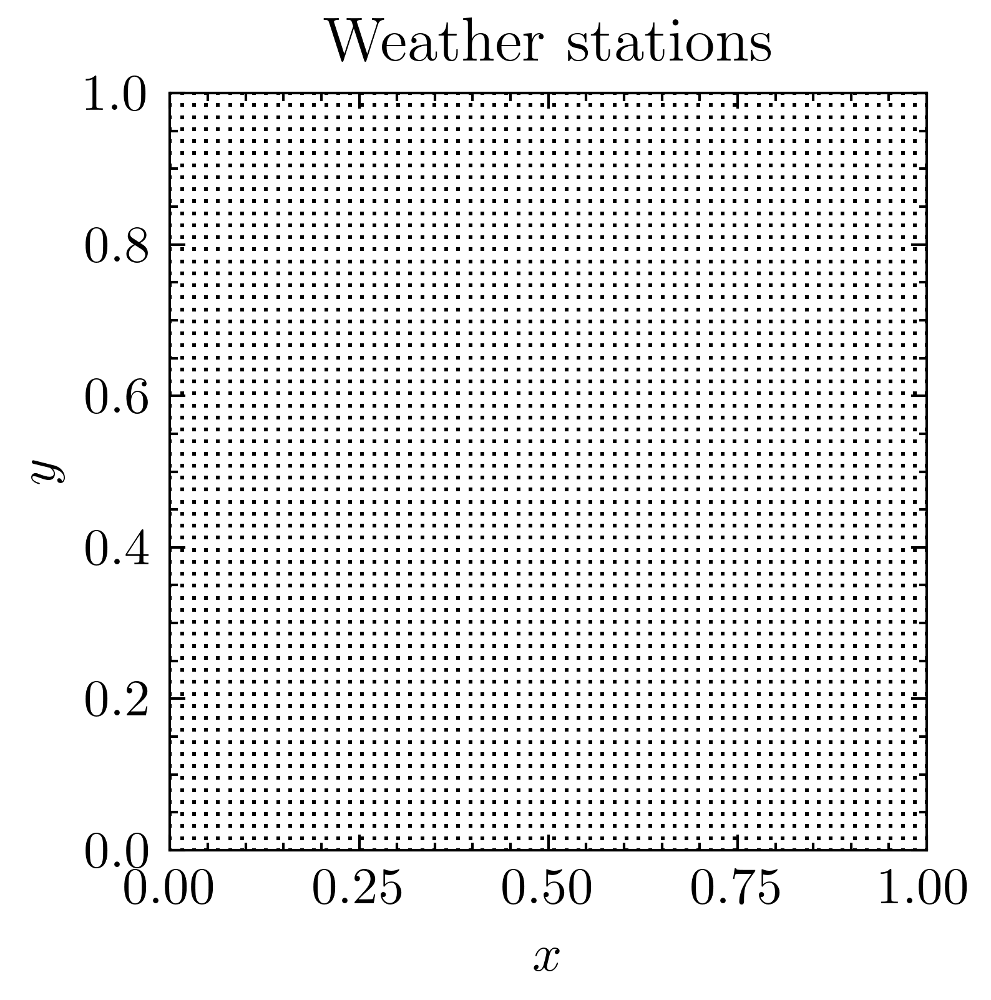

In [12]:
xarrd,yarrd = xy_to_x_and_y(xyarrd)
plt.clf()
fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(xarrd,yarrd,s=0.5,c='k',marker='s',edgecolors='none')
ax.set_aspect('equal')
ax.set_xlim(xmind,xmaxd)
ax.set_ylim(ymind,ymaxd)
plt.xlabel(r'$x$')
plt.ylabel(r'$y$')
plt.title("Weather stations")
plt.savefig(f'{cwd}/EN1_Weather_stations.pdf',dpi=300)
plt.show()

<Figure size 2100x1575 with 0 Axes>

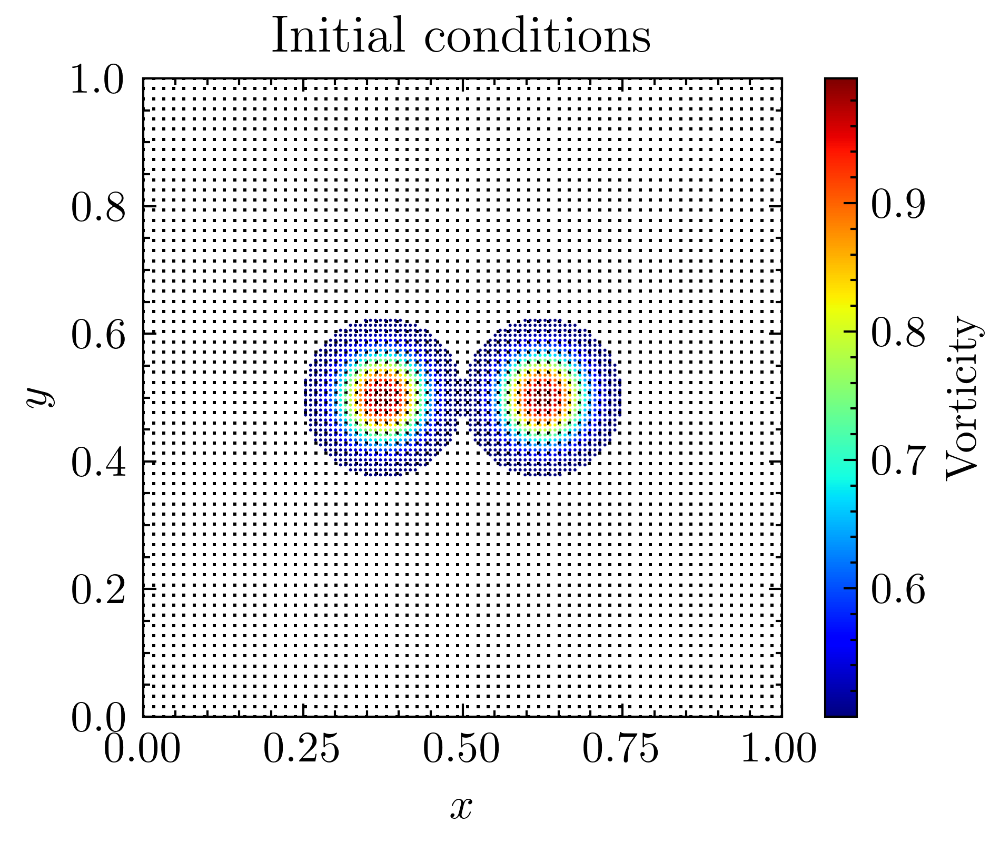

In [13]:
xarrd,yarrd = xy_to_x_and_y(xyarrd)
plt.clf()
fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(xarrd,yarrd,s=0.5,c='k',marker='s',edgecolors='none',label='Weather stations')
xarr0,yarr0 = xy_to_x_and_y(xyarr0)
cax = ax.scatter(xarr0,yarr0,c=carr/(hdx*hdy),s=0.5,marker='o',cmap='jet',edgecolors='none')
ax.set_aspect('equal')
ax.set_xlim(xmind,xmaxd)
ax.set_ylim(ymind,ymaxd)
cbar = fig.colorbar(cax)
cbar.ax.set_ylabel('Vorticity')
plt.xlabel(r'$x$')
plt.ylabel(r'$y$')
plt.title("Initial conditions")
plt.savefig(f'{cwd}/EN1__Weather_stations_and_initial_condition.pdf',dpi=300)
plt.show()

Generate the deterministic flow

In [14]:
xy_det = integrate(ssp33, xyarr0, carr, dts, dbs*0, theta_true, delta)

Below we plot and save the final timestep, deterministic velocity field and, points. 

<Figure size 2100x1575 with 0 Axes>

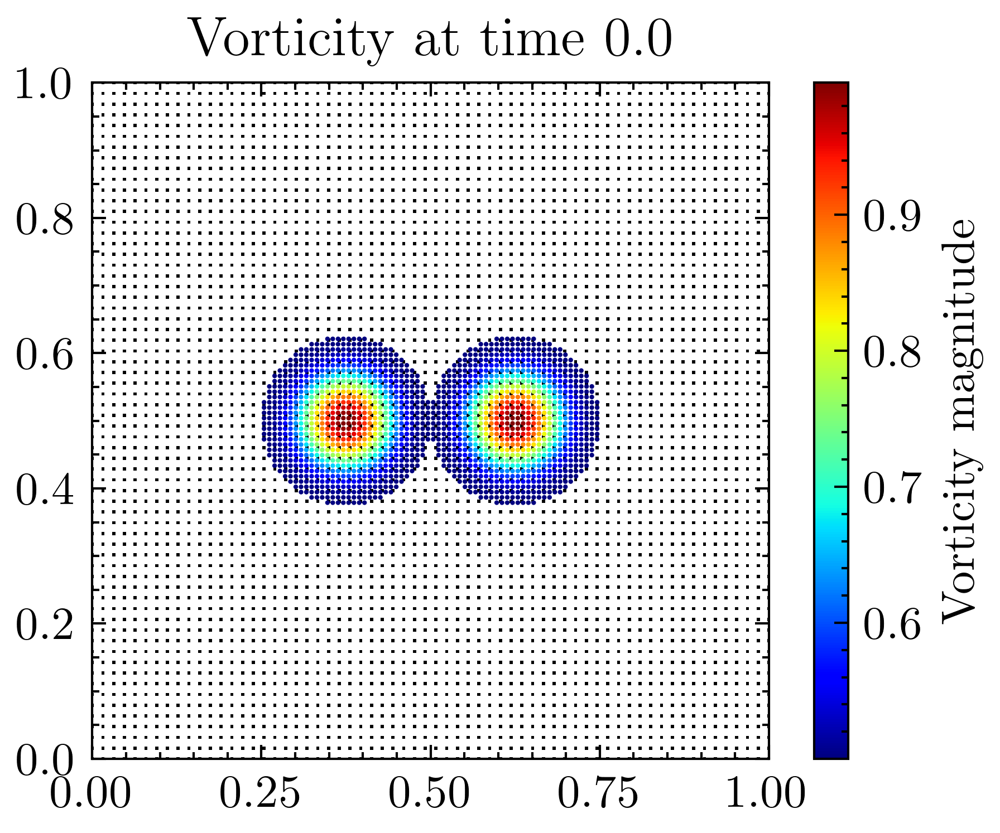

<Figure size 2100x1575 with 0 Axes>

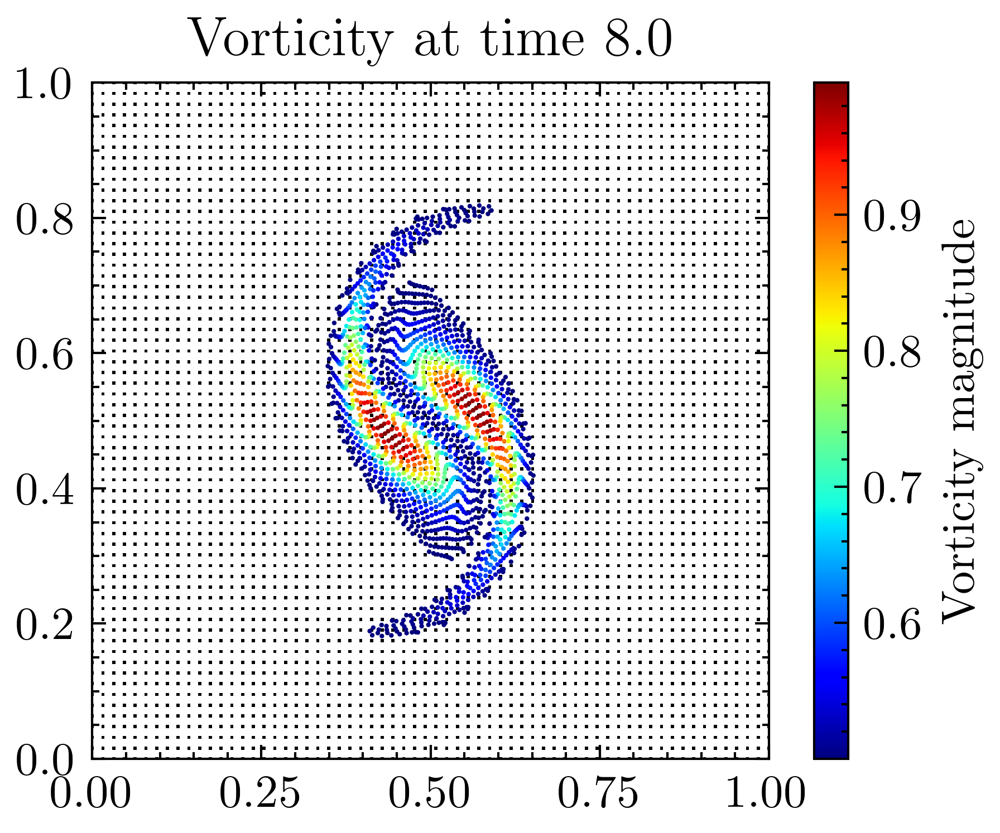

<Figure size 2100x1575 with 0 Axes>

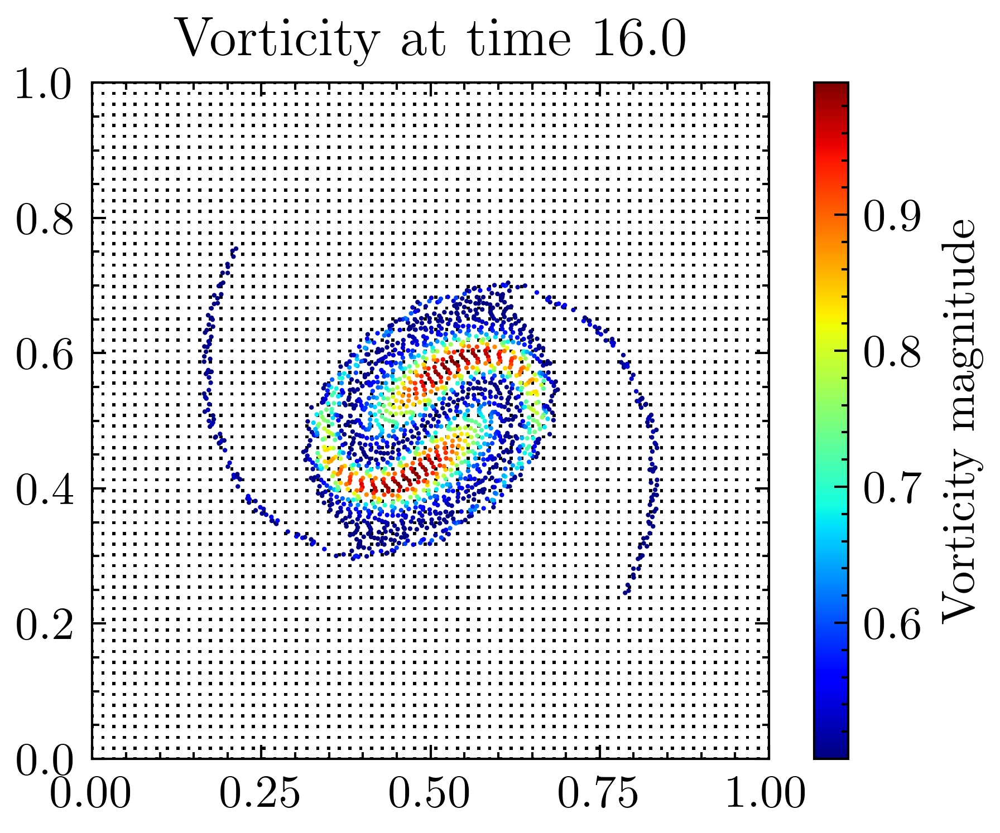

<Figure size 2100x1575 with 0 Axes>

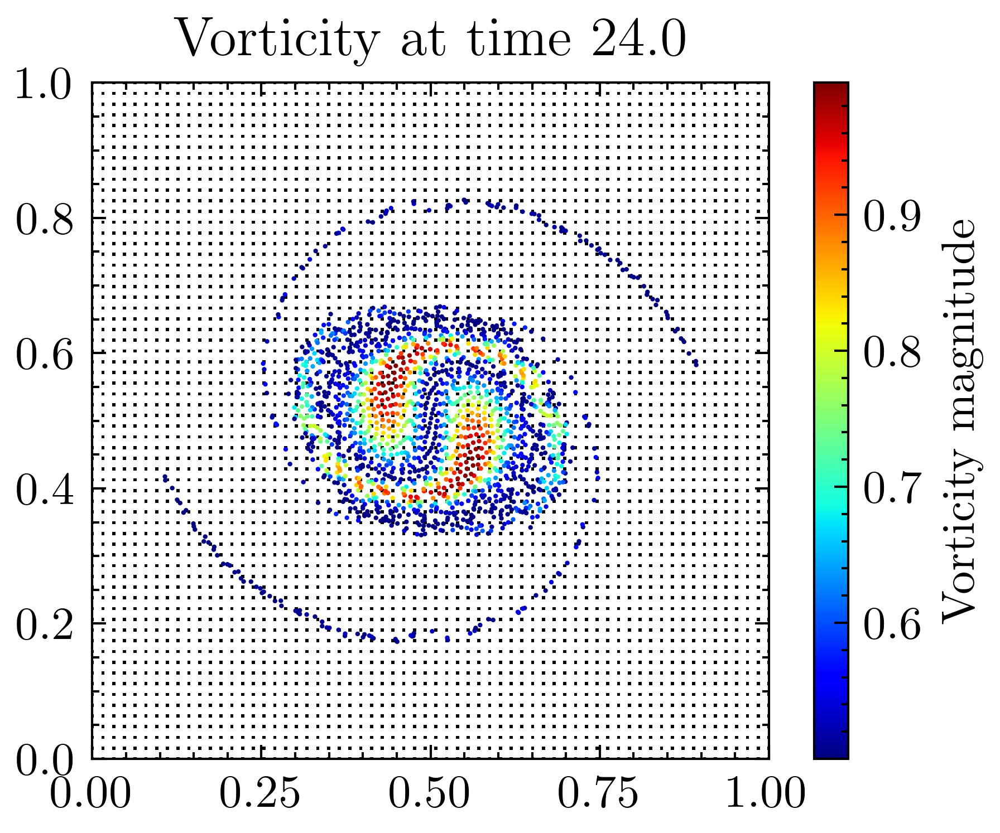

<Figure size 2100x1575 with 0 Axes>

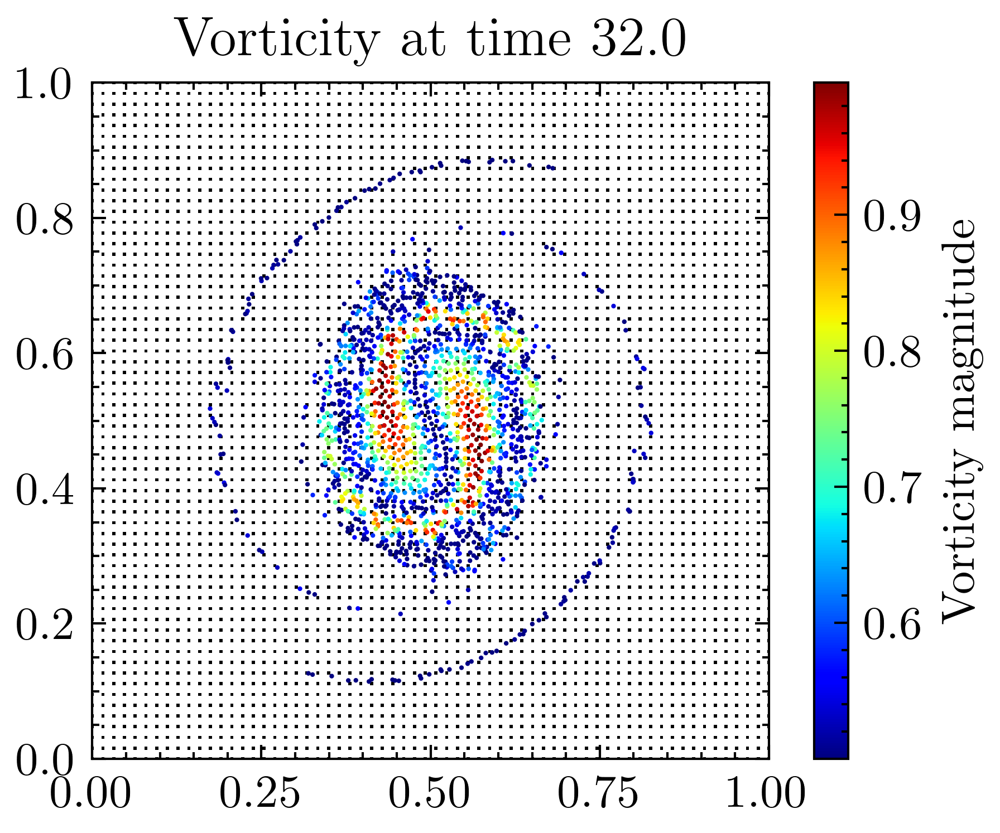

In [15]:
for i in range(0,nt+1,int(nt/2**2)): # nt+1 initial conditions. 
    plt.clf()
    #print(i)
    fig = plt.figure()
    ax = fig.add_subplot()
    ax.scatter(xarrd,yarrd,s=0.5,c='k',marker='s',edgecolors='none',label='Weather stations')
    xarr_det,yarr_det = xy_to_x_and_y(xy_det[i])
    cax = ax.scatter(xarr_det,yarr_det,c=carr/(hdx*hdy),marker='.',s=4,cmap='jet',edgecolors='none')# most info.
    #measured_vel = det_vel(xarrd, yarrd, xarr_det, yarr_det, carr, delta)
    #uarrd,varrd = xy_to_x_and_y(measured_vel)    
    #plt.quiver(xxd,yyd,uarrd.reshape((ND,ND)),varrd.reshape((ND,ND)))
    ax.set_aspect('equal')
    ax.set_xlim(xmind,xmaxd)
    ax.set_ylim(ymind,ymaxd)
    cbar = fig.colorbar(cax)
    cbar.ax.set_ylabel(f'Vorticity magnitude')
    #plt.xlabel(r'$x$')
    #plt.ylabel(r'$y$')
    plt.title(f"Vorticity at time {i*dt}")
    plt.savefig(f'{cwd}/EN1_EN1Deterministic_Weather_stations_and_final_condition_{P}_{i}.pdf',dpi=300)
    plt.show()



We also want plots of observed data at the weather stations.

0


<Figure size 2100x1575 with 0 Axes>

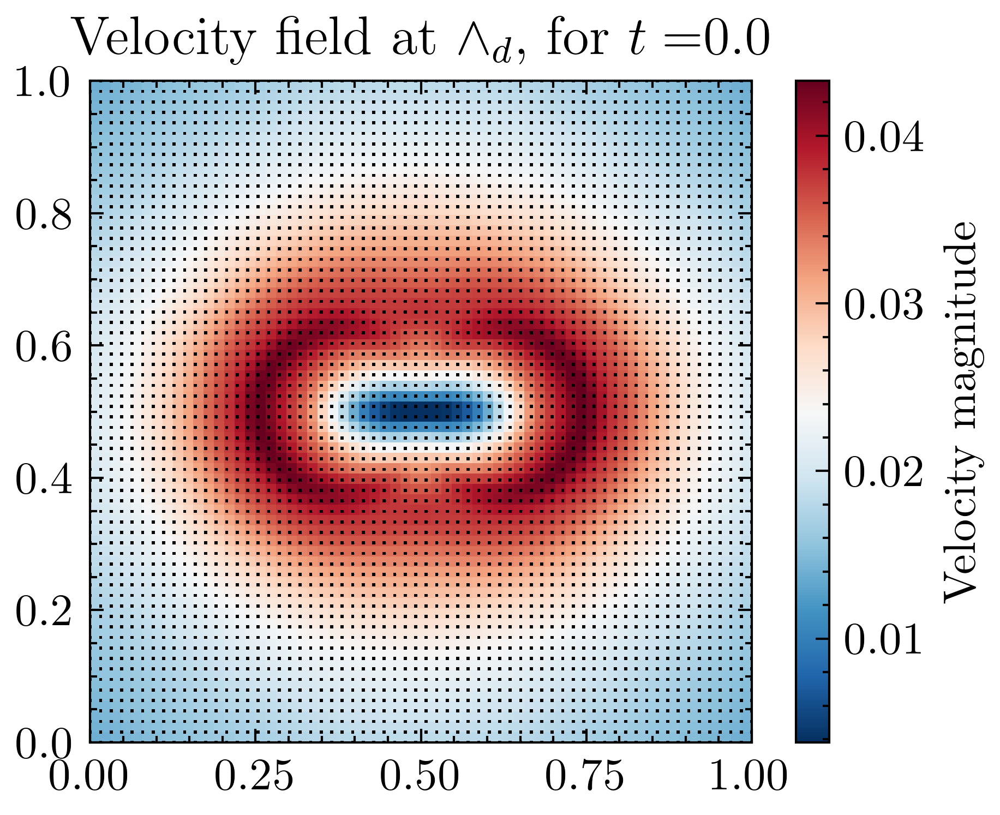

64


<Figure size 2100x1575 with 0 Axes>

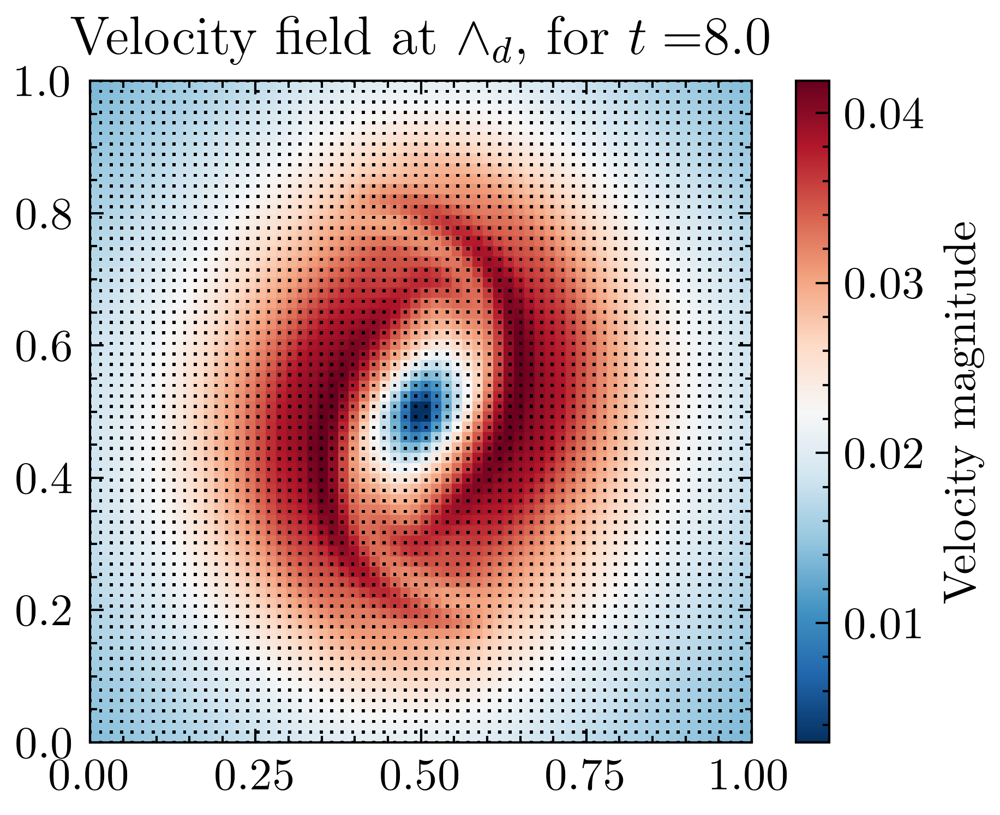

128


<Figure size 2100x1575 with 0 Axes>

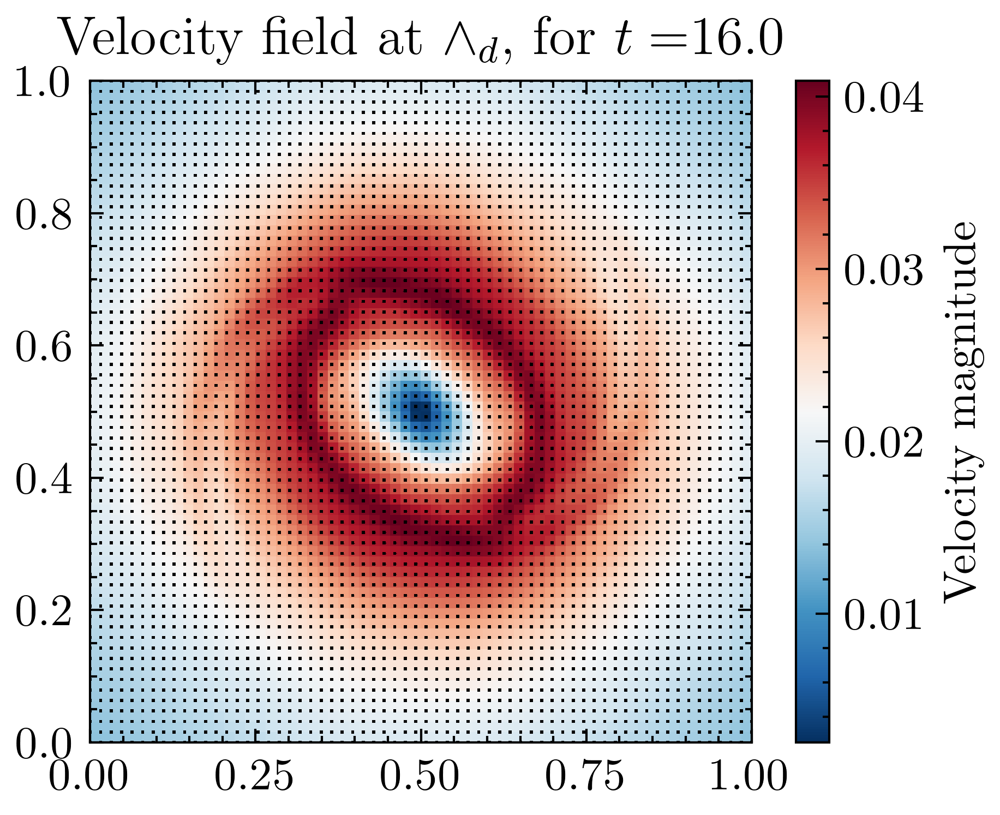

192


<Figure size 2100x1575 with 0 Axes>

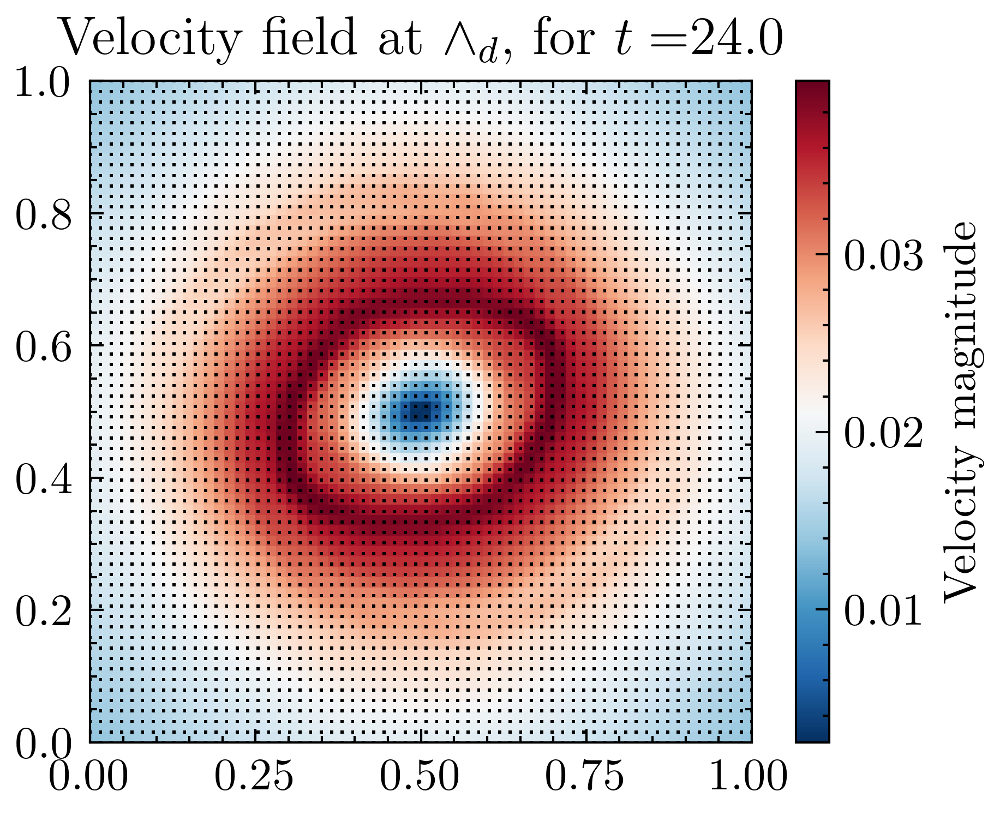

256


<Figure size 2100x1575 with 0 Axes>

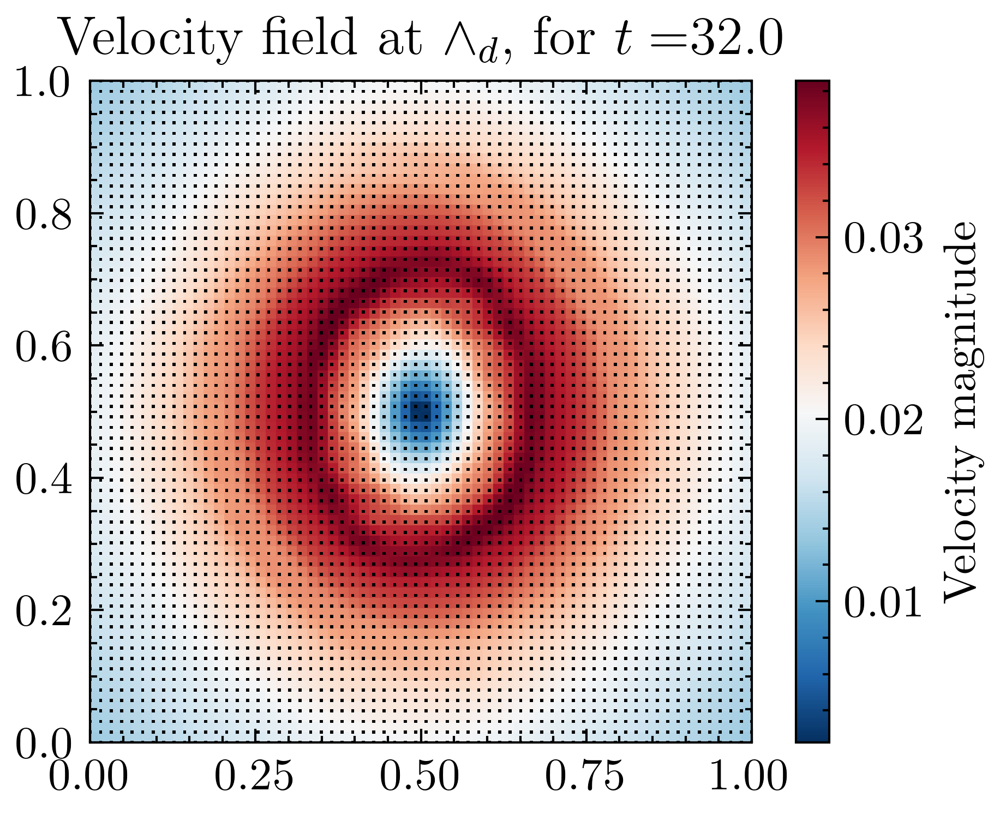

In [16]:
for i in range(0,nt+1,int(nt/2**2)): # nt+1 initial conditions. 
    plt.clf()
    print(i)
    fig = plt.figure()
    ax = fig.add_subplot()
    ax.scatter(xarrd,yarrd,s=0.5,c='k',marker='s',edgecolors='none',label='Weather stations')
    xarr_det,yarr_det = xy_to_x_and_y(xy_det[i])
    #cax = ax.scatter(xarr_det,yarr_det,c=carr/(hdx*hdy),marker='.',s=4,cmap='jet',edgecolors='none')# most info.
    #cax = ax.scatter(xarr_det,yarr_det,c=carr/(hdx*hdy),s=0.5,cmap='jet',edgecolors='none',linewidths=0.1)# most info.
    measured_vel = det_vel(xarrd, yarrd, xarr_det, yarr_det, carr, delta)
    uarrd,varrd = xy_to_x_and_y(measured_vel)    
    plt.quiver(xxd,yyd,uarrd.reshape((ND,ND)),varrd.reshape((ND,ND)),scale=10)
    E = ( uarrd.reshape((ND,ND))**2+varrd.reshape((ND,ND))**2 )**0.5
    ax.title.set_text(f'max magnitude:{np.amax(E):.2e}')
    #im = ax.contour(xxd,yyd,E,alpha=1,levels=10,colors='k', linestyles='-',linewidth=0.1)
    im = ax.imshow(E,extent=[xmind, xmaxd, ymind, ymaxd],cmap=cm.RdBu_r,vmax=np.amax(E))
    ax.set_aspect('equal')
    ax.set_xlim(xmind,xmaxd)
    ax.set_ylim(ymind,ymaxd)
    cbar = fig.colorbar(im)
    cbar.ax.set_ylabel(f'Velocity magnitude') #$\max_{i,j} \sqrt(u_{}^2+v^2)$
    #plt.xlabel(r'$x$')
    #plt.ylabel(r'$y$')
    plt.title(f"Velocity field at $\wedge_d$, for $t=${i*dt}")
    plt.savefig(f'{cwd}/EN1_Deterministic_velocity_Weather_stations_and_final_condition_{P}_{i}.pdf',dpi=300)
    plt.show()


Plot deterministic

In [17]:
# fig = plt.figure()
# ax = fig.add_subplot()
# for i in range(0,len(dts)):
#     if i%10==0:
#         plt.clf()
#         plt.scatter(xarrd,yarrd,s=1,c='k',marker='s',edgecolors='none',label='Weather stations')
#         xarr_det,yarr_det = xy_to_x_and_y(xy_det[i])
#         plt.scatter(xarr_det,yarr_det,c=carr,s=1,cmap='RdBu')
#         display.clear_output(wait=True)
#         display.display(plt.gcf())
#         time.sleep(0.0001)
# plt.show()

Generate Data from stochastic spde run with the true parameters. 

In [18]:
x_true = integrate(ssp33, xyarr0, carr, dts, dbs, theta_true, delta)
# 1min

0


NameError: name 'tot_vel' is not defined

<Figure size 2100x1575 with 0 Axes>

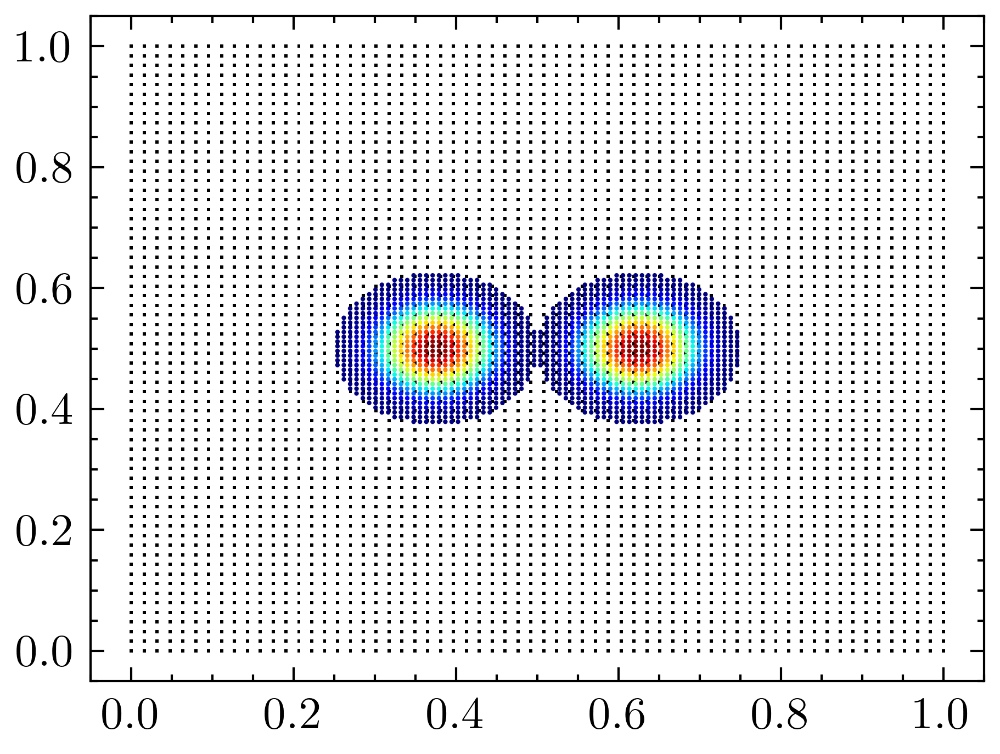

In [19]:
for i in range(0,nt+1,int(nt/2**2)): # nt+1 initial conditions. 
    plt.clf()
    print(i)
    dz = dbs[i]
    fig = plt.figure()
    ax = fig.add_subplot()
    ax.scatter(xarrd,yarrd,s=0.5,c='k',marker='s',edgecolors='none',label='Weather stations')
    xarr,yarr = xy_to_x_and_y(x_true[i])
    cax = ax.scatter(xarr,yarr,c=carr/(hdx*hdy),marker='.',s=4,cmap='jet',edgecolors='none')# most info.
    #cax = ax.scatter(xarr_det,yarr_det,c=carr/(hdx*hdy),s=0.5,cmap='jet',edgecolors='none',linewidths=0.1)# most info.
    #measured_vel = det_vel(xarrd, yarrd, xarr_det, yarr_det, carr, delta)
    measured_vel = tot_vel(xarrd, yarrd, xarr, yarr, carr, delta, theta_true, dz/dt)
    uarrd,varrd = xy_to_x_and_y(measured_vel)    
    #plt.quiver(xxd,yyd,uarrd.reshape((ND,ND)),varrd.reshape((ND,ND)))
    ax.set_aspect('equal')
    ax.set_xlim(xmind,xmaxd)
    ax.set_ylim(ymind,ymaxd)
    cbar = fig.colorbar(cax)
    cbar.ax.set_ylabel(f'Vorticity magnitude')
    #plt.xlabel(r'$x$')
    #plt.ylabel(r'$y$')
    plt.title(f"Vorticity at time {i*dt}")
    plt.savefig(f'{cwd}/EN1_Stochastic_Weather_stations_and_final_condition_{P}_{i}.pdf',dpi=300)
    plt.show()

0


<Figure size 2100x1575 with 0 Axes>

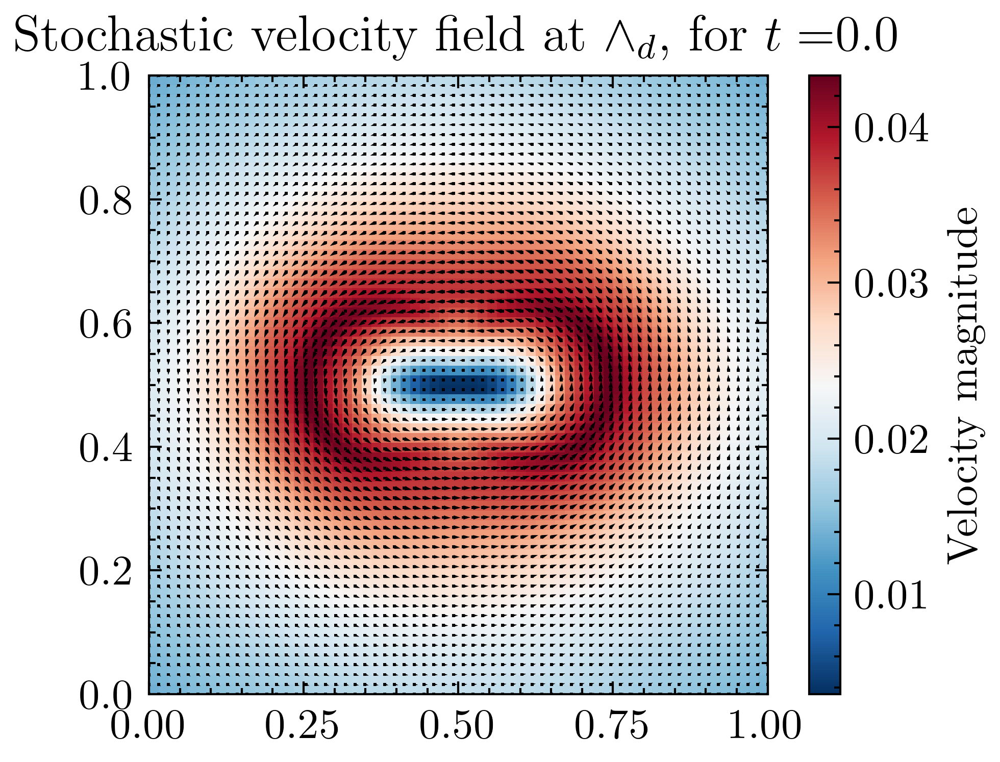

64


<Figure size 2100x1575 with 0 Axes>

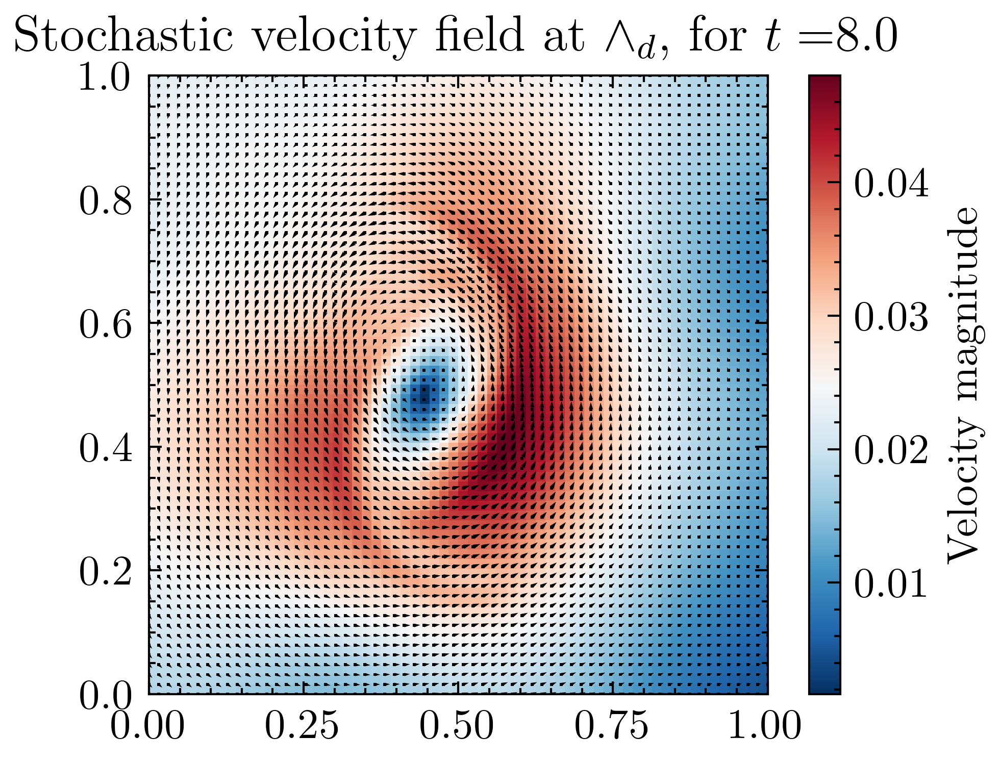

128


<Figure size 2100x1575 with 0 Axes>

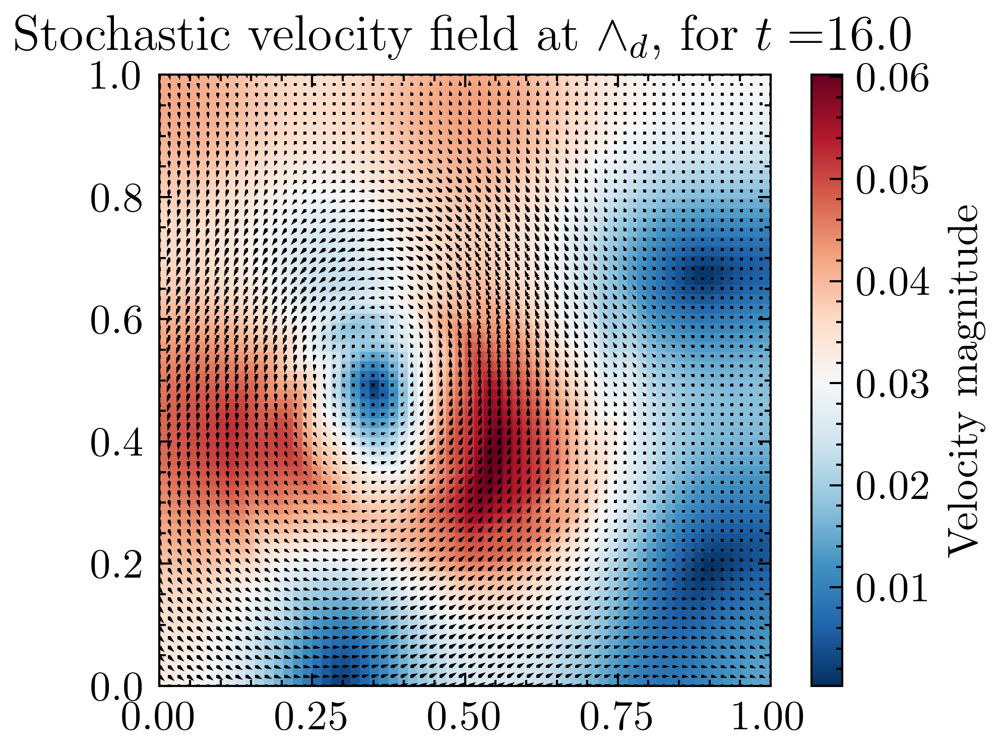

192


<Figure size 2100x1575 with 0 Axes>

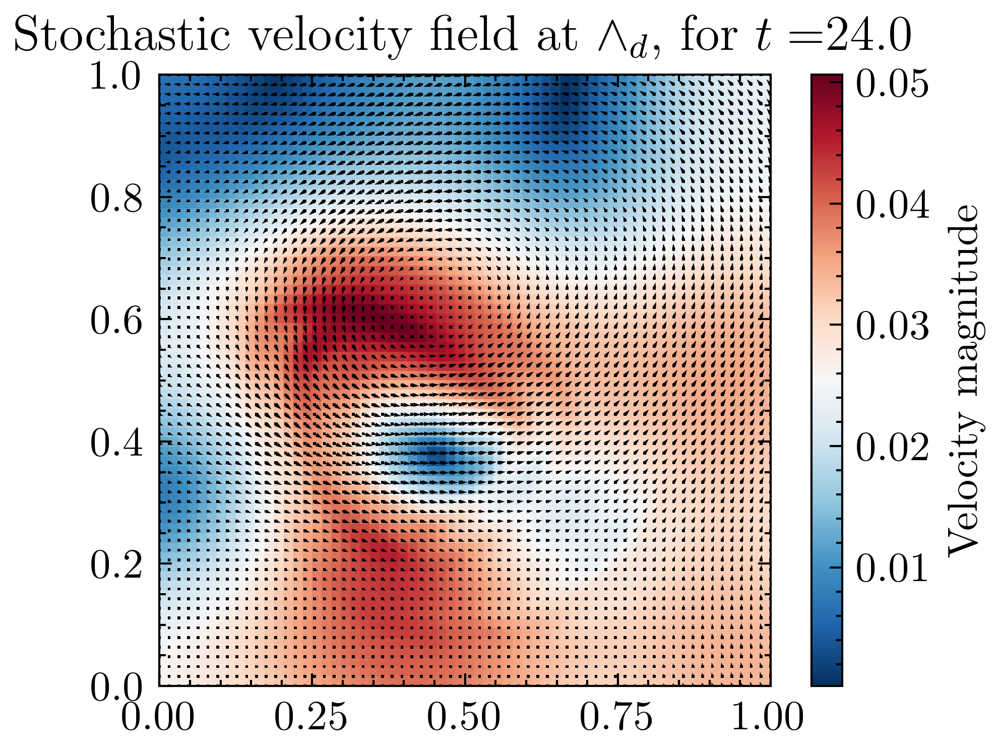

256


<Figure size 2100x1575 with 0 Axes>

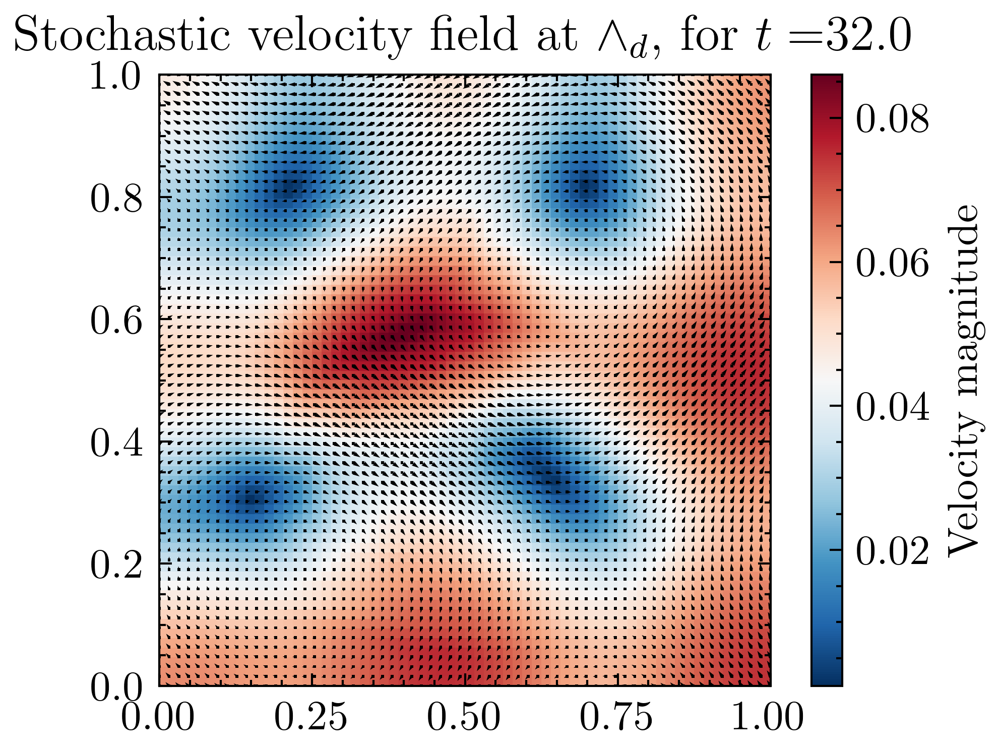

In [262]:
for i in range(0,nt+1,int(nt/2**2)): # nt+1 initial conditions. 
    plt.clf()
    print(i)
    fig = plt.figure()
    ax = fig.add_subplot()
    dz = dbs[i]
    ax.scatter(xarrd,yarrd,s=0.5,c='k',marker='s',edgecolors='none',label='Weather stations')
    xarr,yarr = xy_to_x_and_y(x_true[i])
    #cax = ax.scatter(xarr_det,yarr_det,c=carr/(hdx*hdy),marker='.',s=4,cmap='jet',edgecolors='none')# most info.
    #cax = ax.scatter(xarr_det,yarr_det,c=carr/(hdx*hdy),s=0.5,cmap='jet',edgecolors='none',linewidths=0.1)# most info.
    measured_vel = tot_vel(xarrd, yarrd, xarr, yarr, carr, delta, theta_true, dz/dt)

    uarrd,varrd = xy_to_x_and_y(measured_vel)    
    plt.quiver(xxd,yyd,uarrd.reshape((ND,ND)),varrd.reshape((ND,ND)))
    E = ( uarrd.reshape((ND,ND))**2+varrd.reshape((ND,ND))**2 )**0.5
    ax.title.set_text(f'max magnitude:{np.amax(E):.2e}')
    #im = ax.contour(xxd,yyd,E,alpha=1,levels=10,colors='k', linestyles='-',linewidth=0.1)
    im = ax.imshow(E,extent=[xmind, xmaxd, ymind, ymaxd],cmap=cm.RdBu_r,vmax=np.amax(E))
    ax.set_aspect('equal')
    ax.set_xlim(xmind,xmaxd)
    ax.set_ylim(ymind,ymaxd)
    cbar = fig.colorbar(im)
    cbar.ax.set_ylabel(f'Velocity magnitude') #$\max_{i,j} \sqrt(u_{}^2+v^2)$
    #plt.xlabel(r'$x$')
    #plt.ylabel(r'$y$')
    plt.title(f"Stochastic velocity field at $\wedge_d$, for $t=${i*dt}")
    plt.savefig(f'{cwd}/EN1_Stochastic_velocity_Weather_stations_and_final_condition_{P}_{i}.pdf',dpi=300)
    plt.show()

The next thing to do is to store data (at weather stations) from some reference spde run. 
Namely, we assume that we observe the total velocity field (made up of the sum of the stochastic and deterministic velocity) at the weather centers of interest. for a fixed number of time points. We assume that we observe $ \lbrace t_{min}+\Delta t i | \forall i \in \lbrace 1,...,n_{obs} \rbrace\rbrace $, the first $n_{obs}$ instances. 


In [263]:
# the data (x,y)^T is stored as x_true[timeindex]. 
nobs_min_index=0
nobs_max_index=nt#64
nint=1 # needs to be 1. 
number_of_data_points = int( (nobs_max_index - nobs_min_index)/nint )
print("number of data points:",number_of_data_points)
x_obs = x_true[nobs_min_index:nobs_max_index:nint]

number of data points: 256


The below code reproduces data that would be observed in real time at the weather stations during the simulation run. 

We also suppose that we have the positions and strengths of the point vortices, we then reconstruct the deterministic velocity contribution from the point vortices using the biot savart kernel, and remove this from the total measured velocity at those weather centers. We then in theory can recover the stochastic velocity contribution to the point vortex system. 

We do this after the fact, primarily for presentation purposes, and to ensure the correct vectorisation. 

In [264]:
uv_dam = jnp.zeros([number_of_data_points,2*ND**2])
for i in range(0,number_of_data_points):
    dz = dbs[i]
    theta = theta_true
    #xyarr = ssp33(xyarr, carr, sigma, dt, dz, theta, delta)
    xarr,yarr = xy_to_x_and_y(x_true[i])
    measured_vel = tot_vel(xarrd, yarrd, xarr, yarr, carr, delta, theta, dz/dt)
    recon_det_vel = det_vel(xarrd, yarrd, xarr, yarr, carr, delta)
    uv_dam = (uv_dam).at[i,:].set( (measured_vel-recon_det_vel)*dt ) # stochastic contribution, 
    # this should be multiplied by dt

### TODO: include the explanation. 

In [265]:
def JW_SVD3(M, P, dt):
    #No Time mean, under the assumption that the svd doesnt require the PCA rescaling. 
    nt,d = M.shape
    #time_mean = np.mean(M,axis = 0)
    #e = np.ones(nt)
    DAM = M #- time_mean #np.outer(e,1/nt*e.T@M)  #DAM = DAM - time_mean# broadcasting.  #(nt,d)
    DAM2 = DAM/np.sqrt(nt*dt)#*np.sqrt(nt)*np.sqrt(dt)
    svd = TruncatedSVD(n_components=P)
    #PCA(n_components=P) also posible to do other algorithm 
    svd.fit(DAM2)
    #print(svd.explained_variance_ratio_)
    Vh = svd.components_ # (d,P) right singular vectors of the input data. (n_components, n_features)
    D = svd.singular_values_ # (P,)
    TSM = np.einsum('ij,kj->ik',DAM2,Vh) # here the index collapses on the spatial dimension, (avoiding transpose)
    #print("timeseries of principle component 1",TSOP[:,0])
    S_TSM = np.einsum('ij,j->ij',TSM,1/D)*np.sqrt(nt*dt)  
    XI = np.einsum('i,ij->ij',D,Vh)
    U = S_TSM # (P,nt)
    return U, D, Vh

def JW_SVD2(M, P, dt):
    "here we divide the data anomaly matrix by sqrt(TMax) then do the SVD as to explain the cov in it " 
    "here we multiply the time scaling back in to the data when getting out the noise increments, this seems more principled somehow." 
    nt,d = M.shape
    time_mean = np.mean(M,axis = 0)
    e = np.ones(nt)
    DAM = M - time_mean #np.outer(e,1/nt*e.T@M)  #DAM = DAM - time_mean# broadcasting.  #(nt,d)
    DAM2 = DAM/np.sqrt(nt*dt)#*np.sqrt(nt)*np.sqrt(dt)
    svd = TruncatedSVD(n_components=P)
    #PCA(n_components=P) also posible to do other algorithm 
    svd.fit(DAM2)
    #print(svd.explained_variance_ratio_)
    Vh = svd.components_ # (d,P) right singular vectors of the input data. (n_components, n_features)
    D = svd.singular_values_ # (P,)
    TSM = np.einsum('ij,kj->ik',DAM2,Vh) # here the index collapses on the spatial dimension, (avoiding transpose)
    #print("timeseries of principle component 1",TSOP[:,0])
    S_TSM = np.einsum('ij,j->ij',TSM,1/D)*np.sqrt(nt*dt)  
    XI = np.einsum('i,ij->ij',D,Vh)
    U = S_TSM # (P,nt)
    U = -U
    Vh = -Vh
    return time_mean, U, D, Vh, TSM, S_TSM


In order to assess how accurately this new basis is calibrated, one can try reconstructing the paths, and the basis. 

In [266]:
time_mean, U, D, Vh, TSM, S_TSM = JW_SVD2(M=uv_dam, P=13, dt=dt)
U1, D1, Vh1 = JW_SVD3(M=uv_dam, P=13, dt=dt)

### Eigenvalues

In [267]:
print(D) # there is only P significant contributions.  
print(D1)# there's some difference. 
print(jnp.sum(jnp.where(jnp.abs(D)>1e-12,1,0)))

[1.17557174e+00 7.18149698e-17 6.34825768e-17 5.99138369e-17
 5.53550181e-17 5.23072660e-17 5.05639021e-17 4.95818251e-17
 4.64765137e-17 3.80346765e-17 3.76350850e-17 3.41696553e-17
 3.13658940e-17]
[1.17574218e+00 9.98322763e-17 9.27621547e-17 7.90686883e-17
 7.28748365e-17 6.60491498e-17 5.27006053e-17 4.39716148e-17
 4.03521950e-17 3.79799424e-17 3.28995935e-17 3.07361295e-17
 2.80713675e-17]
1


# Decomposition. 
$TM(M) = 1/m e_m M$, perform (time)column mean, to assertain the time average, we remove this from the Data anomaly matrix and perform TSVD
$$ M \approx  e_{m} \otimes TM(M)  + c U \Sigma V^{T}/c $$
where $c\in \mathbb{R}$ is a scaling chosen such that $ V^{T}/c $ has variance $\Delta t$. 

# the number of time points 
$\Delta t n_t = T_{max}$

$TM(M) = 1/n_{t} e_{n_{t}} M = \Delta t e_{n_{t}} M =$


In [268]:
print(U.shape,D.shape,Vh.shape)
ans = jnp.linalg.norm( time_mean + jnp.einsum("ij,j,jk->ik",U, D, Vh) - uv_dam)
#ans_again = jnp.outer(jnp.ones(nt),time_mean) + jnp.einsum("ij,j,jk->ik",U, D, Vh) - uv_dam
print(ans)
print(f"we recover the data anomaly matrix to { ans }")
ans2 = jnp.linalg.norm( jnp.einsum("ij,j,jk->ik",U1, D1, Vh1) - uv_dam )
print(f"we recover the data anomaly matrix to { ans2 }")


(256, 13) (13,) (13, 8192)
2.0119688350994786e-13
we recover the data anomaly matrix to 2.0119688350994786e-13
we recover the data anomaly matrix to 2.026877111770708e-13


## Time mean difference, plotted. 
### it is important to check that the time mean difference is small, as to assertain whether you need to add this back in as a deterministic term in the equation. 

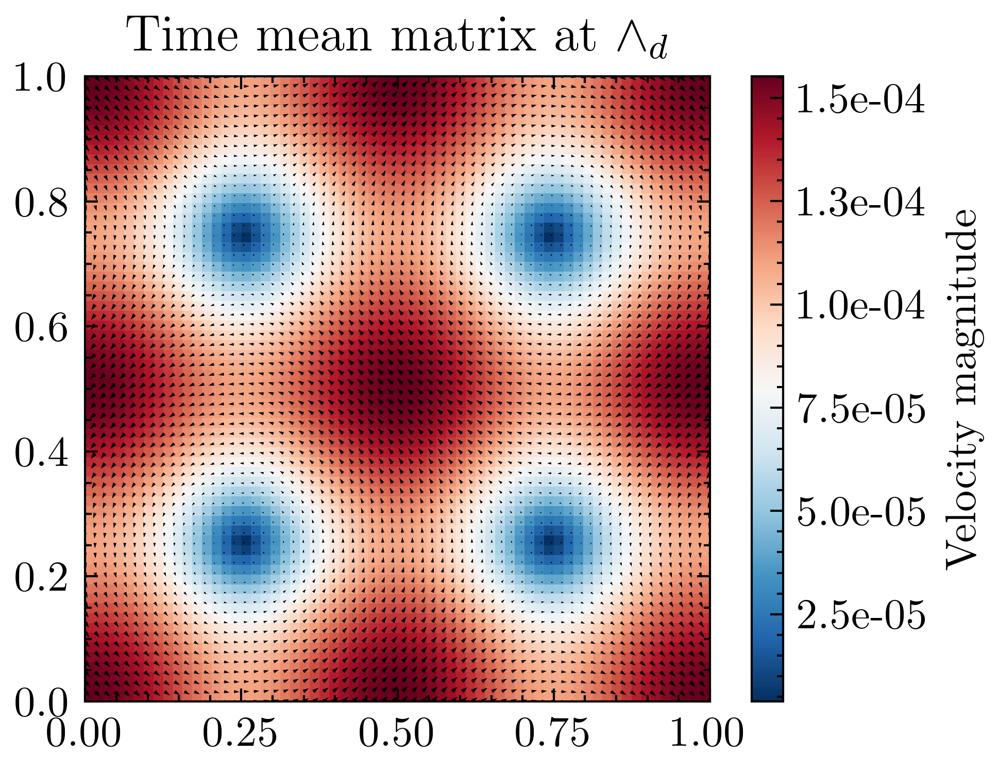

In [269]:
fig = plt.figure()
ax = fig.add_subplot()
uarrd,varrd = xy_to_x_and_y(time_mean)
#plt.title(f'time mean maximum {np.amax((uarrdn**2+varrdn**2)**0.5):.3e}')
# work out what the actual uarrdn is supposed to be. 
plt.quiver(xxd,yyd,uarrd.reshape((ND,ND)),varrd.reshape((ND,ND)))
E = ( uarrd.reshape((ND,ND))**2+varrd.reshape((ND,ND))**2 )**0.5
#ax.title.set_text(f'max magnitude:{np.amax(E):.3e}')
#im = ax.contour(xxd,yyd,E,alpha=1,levels=10,colors='k', linestyles='-',linewidth=0.1)
im = ax.imshow(E,extent=[xmind, xmaxd, ymind, ymaxd],cmap=cm.RdBu_r,vmax=np.amax(E))
ax.set_aspect('equal')
ax.set_xlim(xmind,xmaxd)
ax.set_ylim(ymind,ymaxd)
cbar = fig.colorbar(im,format='%.1e')
cbar.ax.set_ylabel(f'Velocity magnitude') #$\max_{i,j} \sqrt(u_{}^2+v^2)$
cbar.ax.yaxis.set_offset_position('left')

#plt.xlabel(r'$x$')
#plt.ylabel(r'$y$')
plt.title(f"Time mean matrix at $\wedge_d$")
plt.savefig(f'{cwd}/EN1_time_mean_matrix_{P}.pdf',dpi=300)
plt.show()



# Plot the known used basis of noise. 

In [270]:
fig=plt.figure(1,figsize=(8,8))

for i in range(0,P):
    #ax=fig.add_subplot(3,3,i+1) 
    uvarrd_t = sigma(xyarrd, theta_true)
    uarrd_t, varrd_t = xy_to_x_and_y(uvarrd_t)
    ax.tick_params(
    axis='both',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=True,      # ticks along the bottom edge are off
    top=True,         # ticks along the top edge are off
    left=True,      # ticks along the bottom edge are off
    right=True,         # ticks along the top edge are off
    labelbottom=False,
    labelleft=False)
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_aspect('equal')
    if i>=P:
        uarrd_t = uarrd_t.at[:,i].set(0)
        varrd_t = varrd_t.at[:,i].set(0)
    E = ( uarrd_t[:,i].reshape(ND,ND)**2 + varrd_t[:,i].reshape(ND,ND)**2 ) **0.5
    ax.title.set_text(f'max magnitude:{np.amax(E):.2e}')
    fig.subplots_adjust(wspace=0, hspace=0.15)
    
    #im = ax.contourf(xxd,yyd,E,alpha=0.5,levels=100,cmap=cm.RdBu_r)
    #im = ax.imshow(E,extent=[xmind, xmaxd, ymind, ymaxd],cmap=cm.RdBu_r)
    #seed_points = np.array([xarr0, yarr0])
    #ax.plot(seed_points[0], seed_points[1], '.',linewidth=0.01,markersize=0.5)
    #ax.streamplot(np.array(xxd),np.array(yyd),np.array(uarrd.reshape((ND,ND))),np.array(varrd.reshape((ND,ND))), color=np.array(E),start_points=seed_points.T)
    ax.quiver(xxd,yyd,uarrd_t[:,i].reshape((ND,ND)),varrd_t[:,i].reshape((ND,ND)))
    #fig.colorbar(im)

fig.suptitle(r'Predefined $\lbrace \theta_p (\xi^{x}_{p},\xi^{y}_{p})^T \rbrace_{p=1,...,{P}} $ basis evaluated at weather stations',fontsize=12) # or plt.suptitle('Main title')
plt.savefig(f'{cwd}/EN1_predefined_basis_{P}.png',dpi=300)

plt.show()

<Figure size 4800x4800 with 0 Axes>

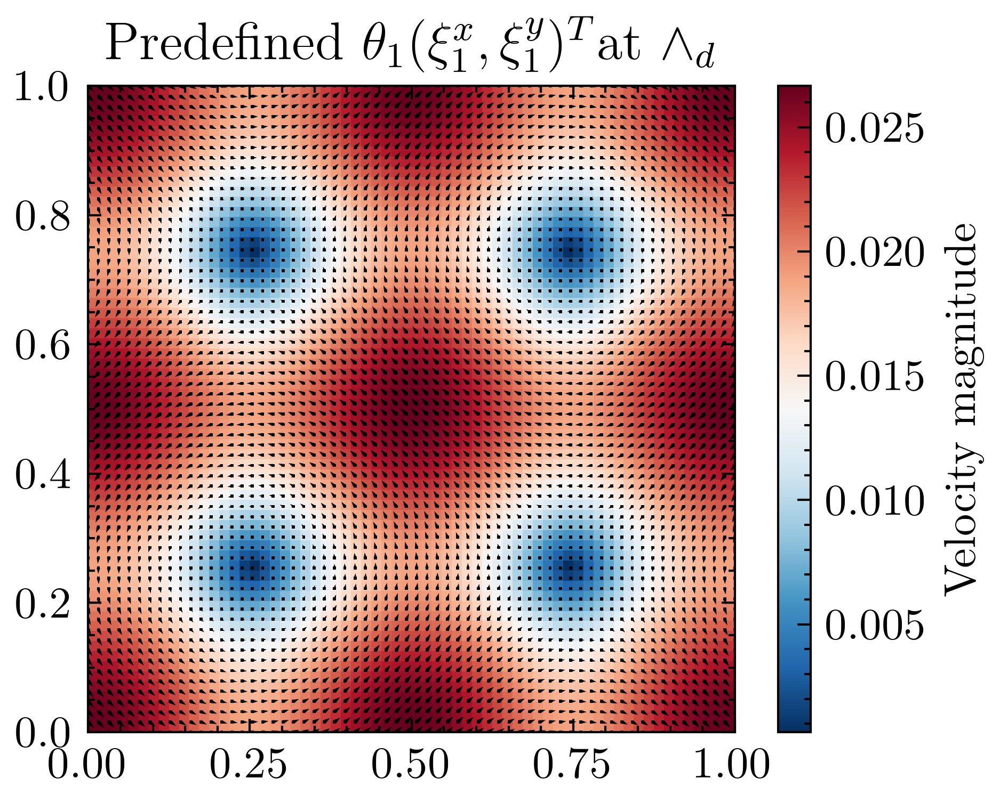

In [271]:
for i in range(0,P): # nt+1 initial conditions. 
    fig = plt.figure()
    ax = fig.add_subplot()
    ax.scatter(xarrd,yarrd,s=0.5,c='k',marker='s',edgecolors='none',label='Weather stations')
    uvarrd_t = sigma(xyarrd, theta_true)
    uarrd_t, varrd_t = xy_to_x_and_y(uvarrd_t)

    ax.tick_params(
    axis='both',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=True,      # ticks along the bottom edge are off
    top=True,         # ticks along the top edge are off
    left=True,      # ticks along the bottom edge are off
    right=True,         # ticks along the top edge are off
    labelbottom=True,
    labelleft=True)
    #ax.set_xticklabels([])
    #ax.set_yticklabels([])
    ax.set_aspect('equal')
    if i>=P:
        uarrd_t = uarrd_t.at[:,i].set(0)
        varrd_t = varrd_t.at[:,i].set(0)
    E = ( uarrd_t[:,i].reshape(ND,ND)**2 + varrd_t[:,i].reshape(ND,ND)**2 ) **0.5
    ax.title.set_text(f'max magnitude:{np.amax(E):.2e}')
    im = ax.imshow(E,extent=[xmind, xmaxd, ymind, ymaxd],cmap=cm.RdBu_r,vmax=np.amax(E))
    ax.quiver(xxd,yyd,uarrd_t[:,i].reshape((ND,ND)),varrd_t[:,i].reshape((ND,ND)))
    ax.set_aspect('equal')
    ax.set_xlim(xmind,xmaxd)
    ax.set_ylim(ymind,ymaxd)
    cbar = fig.colorbar(im)
    
    cbar.ax.set_ylabel(f'Velocity magnitude') 
    cbar.ax.yaxis.set_offset_position('left')
    plt.title(f'Predefined '+f'$\\theta_{i+1}$'+f'$(\\xi^x_{i+1},\\xi^y_{i+1})^T$'+f'at $\wedge_d$')##(\xi^x_{{i+1}},\xi^y_{{i+1}})^T$ basis evaluated at $\wedge_d$'
    plt.savefig(f'{cwd}/EN1_velocity_field_basis_{P}_{i+1}.pdf',dpi=300)
    plt.show()


# Plot the recovered basis Eigenvectors(scaled by eignenvalues). 

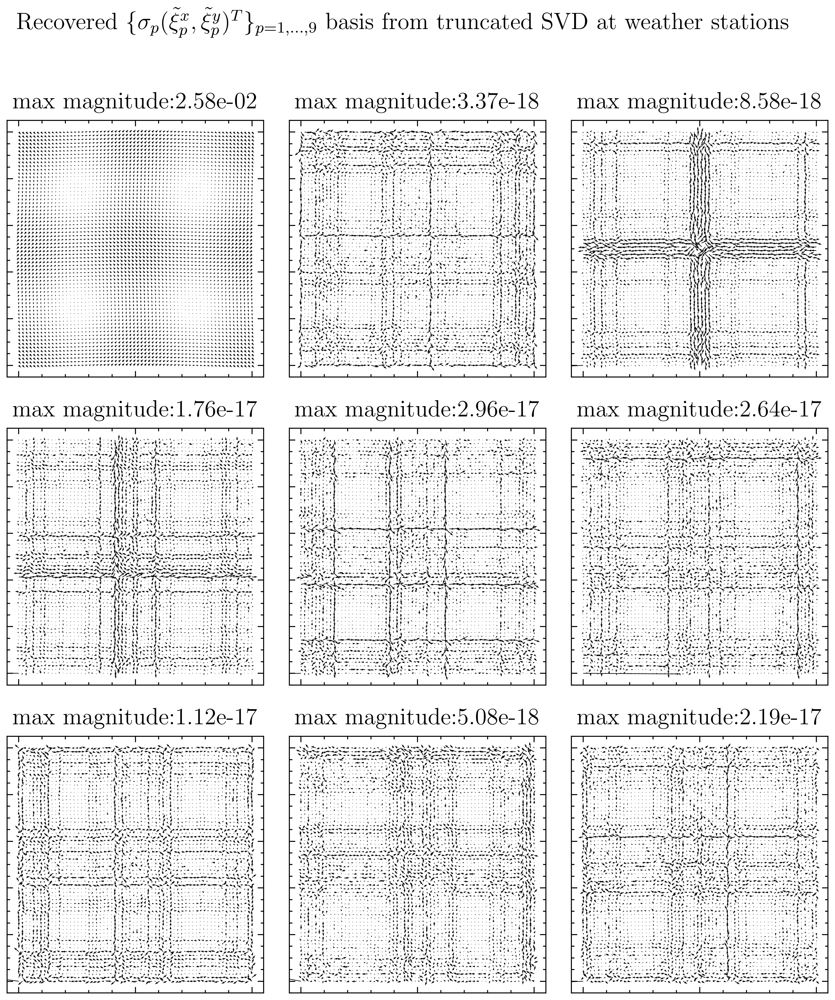

In [272]:
fig=plt.figure(1,figsize=(8,8))
norm = colors.Normalize(vmin=0, vmax=1)
for i in range(0,9):
    ax=fig.add_subplot(3,3,i+1) 
    uarrd,varrd = xy_to_x_and_y(D[i]*Vh[i,:])
    ax.tick_params(
    axis='both',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=True,      # ticks along the bottom edge are off
    top=True,         # ticks along the top edge are off
    left=True,      # ticks along the bottom edge are off
    right=True,         # ticks along the top edge are off
    labelbottom=False,
    labelleft=False)
    #ax.set_xticklabels([])
    #ax.set_yticklabels([])
    ax.set_aspect('equal')
    E = ( uarrd.reshape((ND,ND))**2+varrd.reshape((ND,ND))**2 )**0.5

    ax.title.set_text(f'max magnitude:{np.amax(E):.2e}')
    fig.subplots_adjust(wspace=-0.1, hspace=0.2)
    #im = ax.contour(xxd,yyd,E,alpha=1,levels=10,colors='k', linestyles='-',linewidth=0.1)
    #im = ax.imshow(E,extent=[xmind, xmaxd, ymind, ymaxd],cmap=cm.RdBu_r)

    # seed_points = np.array([xarr0, yarr0])
    # ax.plot(seed_points[0], seed_points[1], '.',linewidth=0.01,markersize=0.5)
    # ax.streamplot(np.array(xxd),np.array(yyd),np.array(uarrd.reshape((ND,ND))),np.array(varrd.reshape((ND,ND))), color=np.array(E),start_points=seed_points.T)
    
    ax.quiver(xxd,yyd,uarrd.reshape((ND,ND)),varrd.reshape((ND,ND)))
    #fig.colorbar(im)

fig.suptitle(r'Recovered $\lbrace \sigma_p (\tilde{\xi}^{x}_{p},\tilde{\xi}^{y}_{p})^T \rbrace_{p=1,...,9} $ basis from truncated SVD at weather stations',fontsize=12) # or plt.suptitle('Main title')
plt.savefig(f'{cwd}/EN1_svd_recovered_basis_{P}.png',dpi=300)
#plt.show()

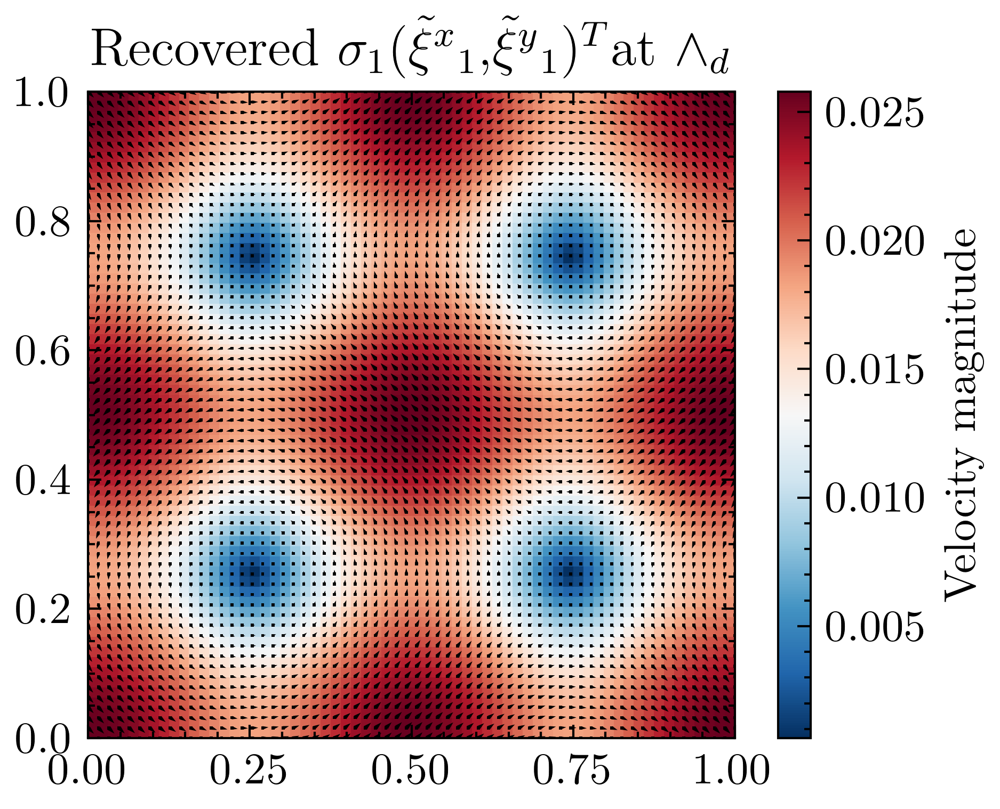

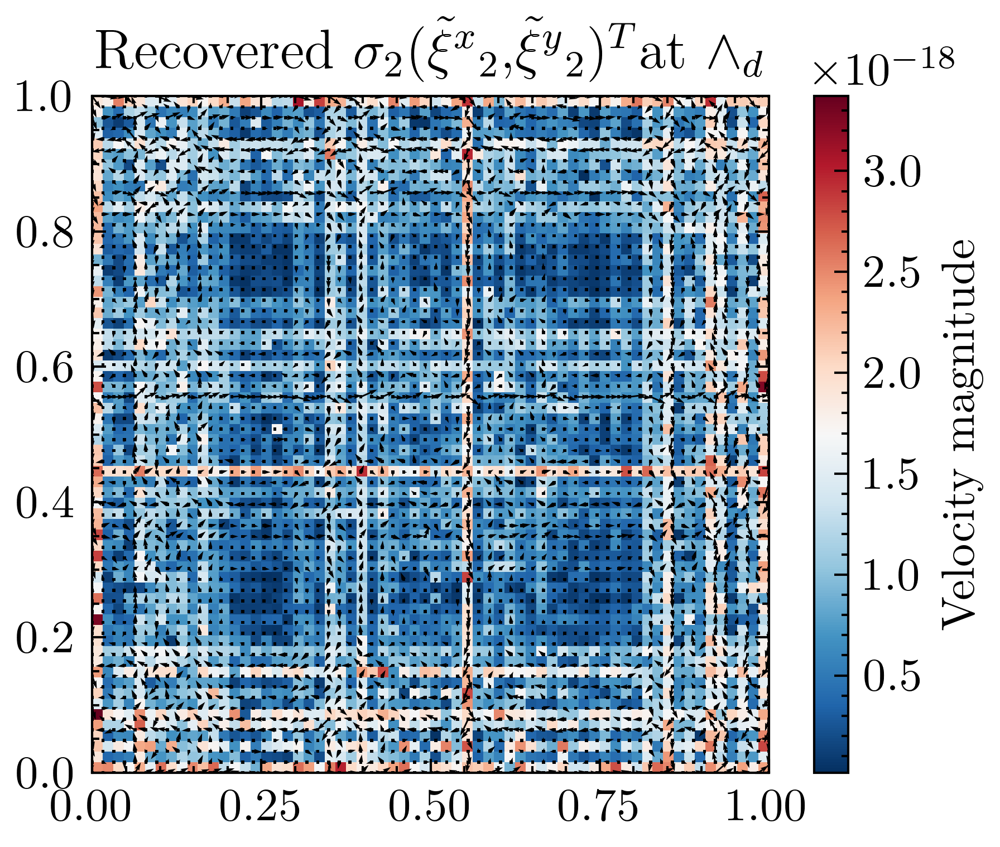

In [273]:
for i in range(0,P+1): # nt+1 initial conditions. 
    fig = plt.figure()
    ax = fig.add_subplot()
    ax.scatter(xarrd,yarrd,s=0.5,c='k',marker='s',edgecolors='none',label='Weather stations')
    uarrd,varrd = xy_to_x_and_y(D[i]*Vh[i,:])

    ax.tick_params(
    axis='both',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=True,      # ticks along the bottom edge are off
    top=True,         # ticks along the top edge are off
    left=True,      # ticks along the bottom edge are off
    right=True,         # ticks along the top edge are off
    labelbottom=True,
    labelleft=True)
    #ax.set_xticklabels([])
    #ax.set_yticklabels([])
    ax.set_aspect('equal')
    E = ( uarrd.reshape(ND,ND)**2 + varrd.reshape(ND,ND)**2 ) **0.5
    ax.title.set_text(f'max magnitude:{np.amax(E):.2e}')
    im = ax.imshow(E,extent=[xmind, xmaxd, ymind, ymaxd],cmap=cm.RdBu_r,vmax=np.amax(E))
    ax.quiver(xxd,yyd,uarrd.reshape((ND,ND)),varrd.reshape((ND,ND)))
    ax.set_aspect('equal')
    ax.set_xlim(xmind,xmaxd)
    ax.set_ylim(ymind,ymaxd)
    cbar = fig.colorbar(im)

    cbar.ax.set_ylabel(f'Velocity magnitude')
    cbar.ax.yaxis.set_offset_position('left')                         
    #plt.title(f'Velocity field basis number {i+1}')
    plt.title(f'Recovered '+f'$\\sigma_{i+1}$'+r'$(\tilde{\xi}^x$'+f'$_{i+1},$'+r'$\tilde{\xi}^y$'+f'$_{i+1})^T$'+f'at $\wedge_d$')
    plt.savefig(f'{cwd}/EN1_recovered_velocity_field_basis_{P}_{i+1}.pdf',dpi=300)
    plt.show()

In [274]:
i=0
uarrd, varrd = xy_to_x_and_y(D[i]*Vh[i,:])
uarrd_svd_new, varrd_svd_new = xy_to_x_and_y(D1[i]*Vh1[i,:])

uvarrd_t = sigma(xyarrd, theta_true)
uarrd_t, varrd_t = xy_to_x_and_y(uvarrd_t)
ut = uarrd_t[:,i]; vt = varrd_t[:,i]
#im = plt.imshow(uarrd.reshape(ND,ND) + ut.reshape(ND,ND) ) # somehow it is the other sign?
#cbar = fig.colorbar(im)
#plt.show()
relative_x_norm = jnp.linalg.norm( uarrd.reshape(-1) - ut.reshape(-1) ) / jnp.linalg.norm( ut.reshape(-1) )
relative_y_norm = jnp.linalg.norm( varrd.reshape(-1) - vt.reshape(-1) ) / jnp.linalg.norm( vt.reshape(-1) )
print(f'The relative L2 error between the driven and the recovered is {(relative_x_norm**2+relative_y_norm**2)**0.5}')


The relative L2 error between the driven and the recovered is 0.04674816414926268


Recovered time series, over the observed data points. Hard to distinguish distributions. P=1 recovers the increment up to sign. 

In [275]:
print(dbs[:10,0])
print(-U[:10,0])
print(-U1[:10,0])

print( jnp.linalg.norm(dbs[:,0] + U[:,0]))
print( jnp.linalg.norm(dbs[:,0] + U1[:,0])) # path more accurate when time mean not taken into consideration

[-0.00120331  0.17356944  0.54009657 -0.03785896 -0.10568093 -0.45101573
  0.13660307 -0.12777017 -0.14004489 -0.11910019]
[ 0.00726512 -0.17348241 -0.55253963  0.04517388  0.11531442  0.47245483
 -0.1352523   0.1381588   0.15085314  0.12919243]
[-0.00124426  0.17947707  0.55847933 -0.03914753 -0.1092779  -0.46636654
  0.1412525  -0.13211897 -0.14481147 -0.1231539 ]
11.127105720383293
0.18619961583312541


(256, 1)
(256, 13)
relative error norm 3.818701e-02
mean: -6.4e-16, should be 0
var/dt:1.0, should be 1
third moment:0.00089, should be 0
fourth moment/dt**2:2.727e+00,should be 3
fifth moment:-0.0056, should be 0
sixth moment/dt**6:12.235792192108597,should be 15
The Shapiro-Wilk test tests the null hypothesis that the data was drawn from a normal distribution gives a W score of 0.989228, and p value of 0.0538488
ShapiroResult(statistic=0.9892277121543884, pvalue=0.0538487583398819)
We perform the two-sample goodness of fit Kolmogorov-Smirnov test for Z , U/\Delta t.
to test the null hypothesis that the recovered increments are distributed according to the appropriately scaled normal distribution
KstestResult(statistic=0.03515625, pvalue=0.9975131965823585, statistic_location=-0.1602087735521918, statistic_sign=1)
The p-value of 0.9975131965823585 is not below the threshold of 0.05, so we cannot reject the null hypothesis that this sample is distributed according to the standard norma

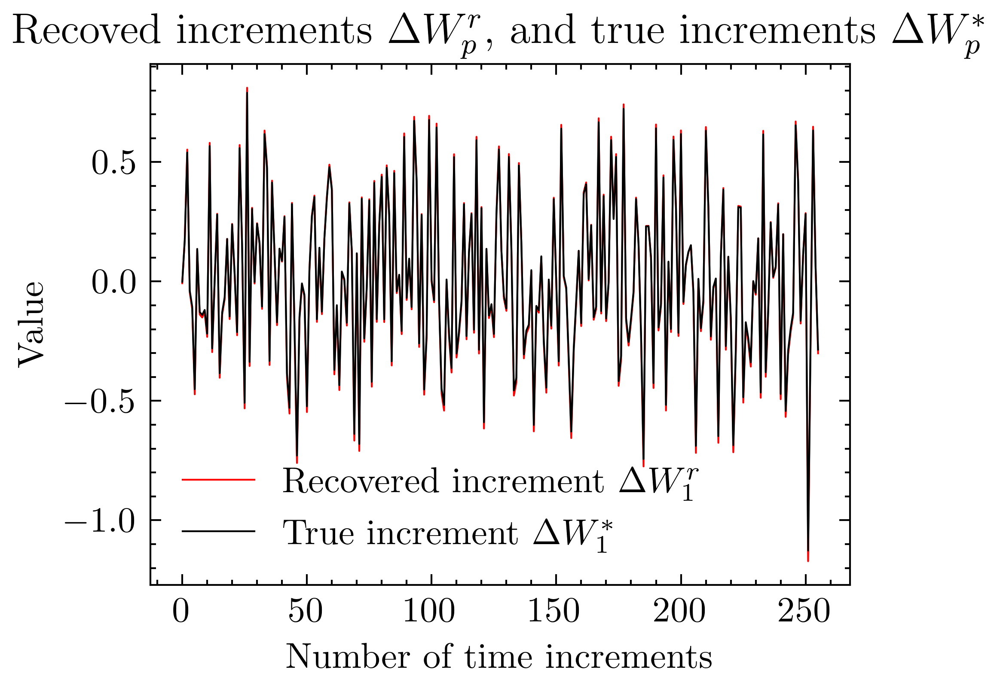

Recovery of the path to relative error 2.0339623802829023


In [276]:
import scipy
from scipy import stats

print(dbs.shape) # dbs has more increments.  # used increments with actual basis
print(U.shape) # recovered, increments with new basis.

print(f'relative error norm {jnp.linalg.norm(dbs[:256,0] - U[:256,0],2)/jnp.linalg.norm( dbs[:256,0],2):6e}')

print(f'mean: {np.mean(U[:nobs_max_index,:P]):.2}, should be 0')
print(f'var/dt:{np.var(U[:nobs_max_index,:P])/dt:.2}, should be 1')
print(f'third moment:{np.mean(U[:nobs_max_index,:P]**3):.2}, should be 0')
print(f'fourth moment/dt**2:{np.mean(U[:nobs_max_index,:P]**4)/dt**2:.3e},should be 3')
print(f'fifth moment:{np.mean(U[:nobs_max_index,:P]**5):.2}, should be 0')
print(f'sixth moment/dt**6:{np.mean(U[:nobs_max_index,:P]**6)/dt**3:},should be 15')
res = stats.shapiro(U[:nobs_max_index,:P])
print(f'The Shapiro-Wilk test tests the null hypothesis that the data was drawn from a normal distribution gives a W score of {res.statistic:.6}, and p value of {res.pvalue:.6}')
print(res)
# test the null hypothesis that a sample is distributed according to the standard normal
# we will reject the null hypothesis in favor of the alternative if the p-value is less than 0.05
print(r"We perform the two-sample goodness of fit Kolmogorov-Smirnov test for Z , U/\Delta t.")
print("to test the null hypothesis that the recovered increments are distributed according to the appropriately scaled normal distribution")
result2 = stats.kstest(1*U[:nobs_max_index,0], dbs[:nobs_max_index,0] )#np.random.randn(1000)*(dt**0.5)
print(result2)
print(f"The p-value of {result2.pvalue} is not below the threshold of 0.05, so we cannot reject the null hypothesis that this sample is distributed according to the standard normal with confidence level 95%")
#print(stats.kstest(, stats.norm.cdf))

for i in range(0,P):
    plt.title(r"Recoved increments $\Delta W^{r}_{p}$, and true increments $\Delta W^{*}_{p}$")
    plt.plot(U[:256,i],c='r',label=f'Recovered increment $\Delta W^r_{i+1}$',linewidth=0.5) # seem to have wrong by negative?
    #plt.plot(U1[:256,i],c='r',label=f'Recovered increment p={i+1}',linewidth=0.5) # seem to have wrong by negative?

    plt.plot(dbs[:256,i],c='k',label=f'True increment $\Delta W^*_{i+1}$',linewidth=0.5)
    plt.ylabel('Value')
    plt.xlabel("Number of time increments")

    plt.legend()
    plt.savefig(f'{cwd}/EN1_recovered_noise_increment_{P}_{i+1}.pdf',dpi=300)
    plt.show()
# print(scipy.stats.moment(a=U[:1000,:],moment=3))
# print(scipy.stats.moment(a=dbs[:1000,:],moment=3))

print("Recovery of the path to relative error", jnp.linalg.norm(U[:256,0] + dbs[:256,0])/jnp.linalg.norm(dbs[:256,0]))


In [277]:
res = anderson(U[:nobs_max_index,:P].reshape(-1))#np.random.randn(10000)
# res.statistic
# res.critical_values
# res.significance_level
print(res.statistic,
res.critical_values,
res.significance_level)
print("Test the null hypothesis that a random sample was drawn from a normal distribution (with unspecified mean and standard deviation)")
print("The value of the statistic doesnt exceed the critical values associated with all significance levels, the null hypothesis of normality may not be rejected at all significance levels")

mean = scipy.stats.moment(U[:nobs_max_index,:P].reshape(-1),1)
var = scipy.stats.moment(U[:nobs_max_index,:P].reshape(-1),2)/dt
third = scipy.stats.moment(U[:nobs_max_index,:P].reshape(-1),3)#/(dt**(3/2))
fourth = scipy.stats.moment(U[:nobs_max_index,:P].reshape(-1),4)/dt**2
fifth = scipy.stats.moment(U[:nobs_max_index,:P].reshape(-1),5)
sixth = scipy.stats.moment(U[:nobs_max_index,:P].reshape(-1),6)/dt**3

df = pd.DataFrame(dict(moment=[r'\mathbb{E}(dW_r)', r'\mathbb{E}(dW_r^2)/ \delta t',r'\mathbb{E}(dW_r^3)',r'\mathbb{E}(dW_r^4)/ \delta t^2',r'\mathbb{E}(dW_r^5)',r'\mathbb{E}(dW_r^6)/ \delta t^3'],
                       value= [f'{np.mean(U[:nobs_max_index,:P]):.3e}', f'{np.var(U[:nobs_max_index,:P])/dt:.3e}',f'{third:.3e}',f'{fourth:.3e}',f'{fifth:.3e}',f'{sixth:.3e}'],
                       expected=[0,1,0,3,0,15]))
print(df.to_latex(index=False,
                  formatters={"name": str},
                  float_format="{:.1f}".format,
))  

0.7686161674964751 [0.567 0.646 0.775 0.904 1.076] [15.  10.   5.   2.5  1. ]
Test the null hypothesis that a random sample was drawn from a normal distribution (with unspecified mean and standard deviation)
The value of the statistic doesnt exceed the critical values associated with all significance levels, the null hypothesis of normality may not be rejected at all significance levels
\begin{tabular}{llr}
\toprule
moment & value & expected \\
\midrule
\mathbb{E}(dW_r) & -6.436e-16 & 0 \\
\mathbb{E}(dW_r^2)/ \delta t & 1.000e+00 & 1 \\
\mathbb{E}(dW_r^3) & 8.875e-04 & 0 \\
\mathbb{E}(dW_r^4)/ \delta t^2 & 2.727e+00 & 3 \\
\mathbb{E}(dW_r^5) & -5.641e-03 & 0 \\
\mathbb{E}(dW_r^6)/ \delta t^3 & 1.224e+01 & 15 \\
\bottomrule
\end{tabular}



We now aim for an ensemble point vortex run with calibrated fields. We need to be able to evaluate at points dynamically evolving through the grid. 

To do so requires an interpolation proceedure, if we assume periodic and smooth vectorfields are used then we can use fourier interpolation. We do so in the understanding, that the points typically remain in $[x_{\min,d},x_{\max,d}]\times[y_{\min,d},y_{\max,d}]$, and the basis function should be periodic. 

In [278]:
def spectral_mesh(nx,ny,xmin,xmax,ymin,ymax):
    # nx, ny = len(f[0, :]), len(f[:, 0])
    # xmin = 0.0; xmax = 1.0; ymin = 0.0; ymax = 1.0
    dx = (xmax - xmin)/nx
    dy = (ymax - ymin)/ny
    kx = jnp.fft.fftfreq(nx,dx,dtype=np.complex128) * 1j*2.0*np.pi
    ky = jnp.fft.fftfreq(ny,dy,dtype=np.complex128) * 1j*2.0*np.pi
    kx2d, ky2d = jnp.meshgrid(kx, ky,  indexing='xy')
    return kx2d, ky2d

In [279]:
def fft_interp_vec_one_vers(q,x_inputs,y_inputs,kx2d,ky2d): 
    # x,y are flattened positions for x,y  
    coeffs = jnp.fft.fft2(q) # nx_c, nx_c size matrix 
    A = jnp.einsum('i,kl->ikl',x_inputs[:],kx2d[:,:]) 
    B = jnp.einsum('i,kl->ikl',y_inputs[:],ky2d[:,:]) 
    eikx = jnp.exp( A+B ) 
    out = jnp.einsum('acd,cd->a', eikx, coeffs)
    # ijkl tensor, dimensions output dim^2, interpolation dim^2
    sixe = len(q.reshape(-1))
    out = out/sixe
    return jnp.real(out)

def velocity_at_points_one_vers(u,v,x_inputs,y_inputs,kx2d,ky2d):
    u_velocities = fft_interp_vec_one_vers(u,x_inputs,y_inputs,kx2d,ky2d)
    v_velocities = fft_interp_vec_one_vers(v,x_inputs,y_inputs,kx2d,ky2d)
    return  u_velocities, v_velocities


@partial(jit, static_argnums=(5,6,7,8,9))
def Vel_fields_at_flattened_xypoints(xyfine,xyarrd,D,Vh,i,xmind=xmind,xmaxd=xmaxd,ymind=ymind,ymaxd=ymaxd,ND=ND):
    """Evaluate a fourier interpolated recovered field, at the xyfine points. """
    _uarrd,_varrd = xy_to_x_and_y(D[i]*Vh[i,:])
    # size of corresponding data meshgrid corresponding to the weather stations. 
    #ND = int(jnp.sqrt(len(_uarrd)))
    _uarrd = _uarrd.reshape(ND,ND) 
    _varrd = _varrd.reshape(ND,ND)
    # generate a meshgrid. based off weather centers. 
    kx2d, ky2d = spectral_mesh(nx=ND,ny=ND,xmin=xmind,xmax=xmaxd,ymin=ymind,ymax=ymaxd)
    #get x,y positions in which we interpolate from the weather centers. 
    xarrfine,yarrfine = xy_to_x_and_y(xyfine)
    #NF = int( np.sqrt( len( xarrfine ) ) )
    #xnew = xarrfine.reshape(NF,NF) # here we are assuming that the reshape makes sense in the normal setting?
    #ynew = yarrfine.reshape(NF,NF) # why do we assume a meshgrid
    Ud,Vd = velocity_at_points_one_vers(u=_uarrd,v=_varrd,x_inputs=xarrfine,y_inputs=yarrfine,kx2d=kx2d,ky2d=ky2d)

    return Ud,Vd

@partial(jit, static_argnums=(5,6,7,8,9))
def Vel_fields_at_flattened_xypoints1(xyfine,xyarrd,D1,Vh1,i,xmind=xmind,xmaxd=xmaxd,ymind=ymind,ymaxd=ymaxd,ND=ND):
    _uarrd,_varrd = xy_to_x_and_y(D1[i]*Vh1[i,:])
    _uarrd = _uarrd.reshape(ND,ND) 
    _varrd = _varrd.reshape(ND,ND)
    kx2d, ky2d = spectral_mesh(nx=ND,ny=ND,xmin=xmind,xmax=xmaxd,ymin=ymind,ymax=ymaxd)
    xarrfine,yarrfine = xy_to_x_and_y(xyfine)
    Ud,Vd = velocity_at_points_one_vers(u=_uarrd,v=_varrd,x_inputs=xarrfine,y_inputs=yarrfine,kx2d=kx2d,ky2d=ky2d)
    return Ud,Vd


We now want to plot the time mean

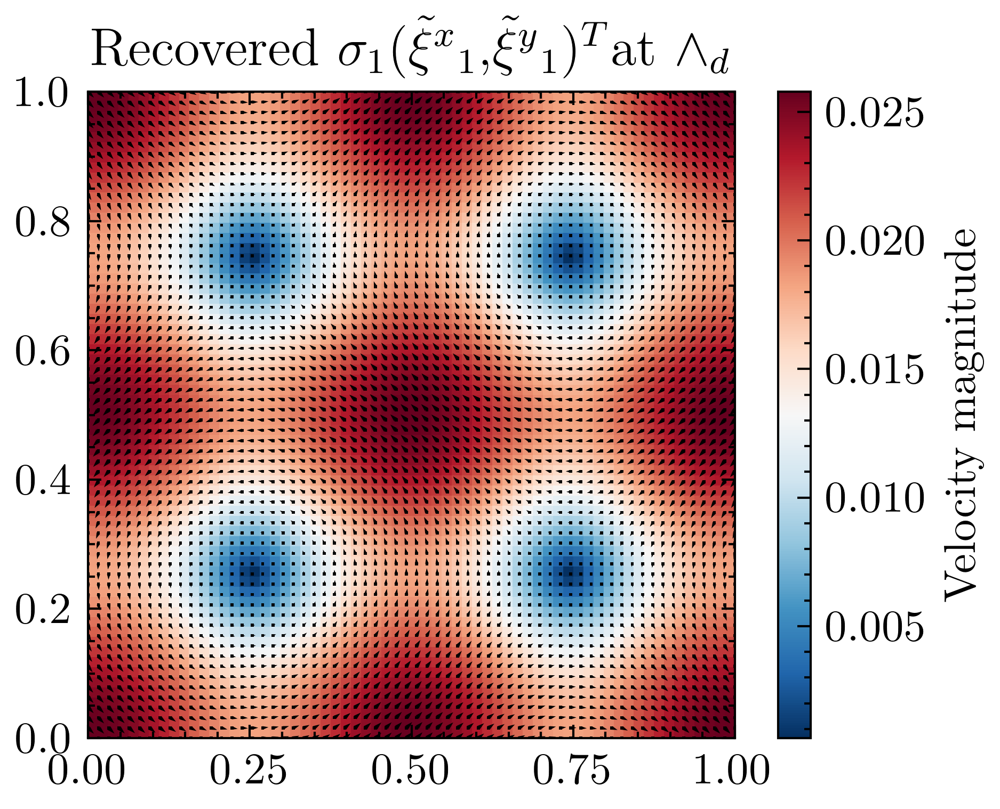

In [280]:
fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(xarrd,yarrd,s=0.5,c='k',marker='s',edgecolors='none',label='Weather stations')
uarrd,varrd = xy_to_x_and_y(D[i]*Vh[i,:])
ax.tick_params(
axis='both',          # changes apply to the x-axis
which='both',      # both major and minor ticks are affected
bottom=True,      # ticks along the bottom edge are off
top=True,         # ticks along the top edge are off
left=True,      # ticks along the bottom edge are off
right=True,         # ticks along the top edge are off
labelbottom=True,
labelleft=True)
#ax.set_xticklabels([])
#ax.set_yticklabels([])

ax.set_aspect('equal')
E = ( uarrd.reshape(ND,ND)**2 + varrd.reshape(ND,ND)**2 ) **0.5
ax.title.set_text(f'max magnitude:{np.amax(E):.2e}')
im = ax.imshow(E,extent=[xmind, xmaxd, ymind, ymaxd],cmap=cm.RdBu_r,vmax=np.amax(E))
ax.quiver(xxd,yyd,uarrd.reshape((ND,ND)),varrd.reshape((ND,ND)))
ax.set_aspect('equal')
ax.set_xlim(xmind,xmaxd)
ax.set_ylim(ymind,ymaxd)
cbar = fig.colorbar(im,ax=ax)
cbar.ax.set_ylabel(f'Velocity magnitude')
cbar.ax.yaxis.set_offset_position('left')                         
#cbar.update_ticks()

#cbar.ax.yaxis.get_offset_text().set(size=5)
#plt.title(f'Velocity field basis number {i+1}')
plt.title(f'Recovered '+f'$\\sigma_{i+1}$'+r'$(\tilde{\xi}^x$'+f'$_{i+1},$'+r'$\tilde{\xi}^y$'+f'$_{i+1})^T$'+f'at $\wedge_d$')
plt.savefig(f'{cwd}/EN1_recovered_time_mean_velocity_field_P{P}.pdf',dpi=300)
plt.show()

In [281]:
i=0
NF = 100
xf = jnp.linspace(xmind,xmaxd,NF) 
xxf,yyf = jnp.meshgrid(xf,xf) 
xarrf = xxf.reshape(-1); yarrf = yyf.reshape(-1)
xyarrf = x_and_y_to_xy(xarrf, yarrf)
# # reshaped flattened meshgrid of x,y positions. 
# #Uf,Vf = Vel_fields_at_points(xyarrf,xyarrd,D,Vh,i,xmind,xmaxd,ymind,ymaxd)
# Uf,Vf = Vel_fields_at_flattened_xypoints(xyarrf,xyarrd,D,Vh,i,xmind,xmaxd,ymind,ymaxd,ND)
# print(Uf.shape)
# EF = ( Uf.reshape((NF,NF))**2+Vf.reshape((NF,NF))**2 )**0.5
# plt.title(f"{np.amax(EF)}")
# plt.quiver(xxf,yyf,Uf.reshape((NF,NF)),Vf.reshape((NF,NF)))
# plt.show()

# Ud,Vd = Vel_fields_at_flattened_xypoints(xyarrd,xyarrd,D,Vh,i,xmind,xmaxd,ymind,ymaxd,ND)
# plt.quiver(xxd,yyd,Ud.reshape((ND,ND)),Vd.reshape((ND,ND)))
# ED = ( Ud.reshape((ND,ND))**2+Vd.reshape((ND,ND))**2 )**0.5
# plt.title(f"{np.amax(ED)}")


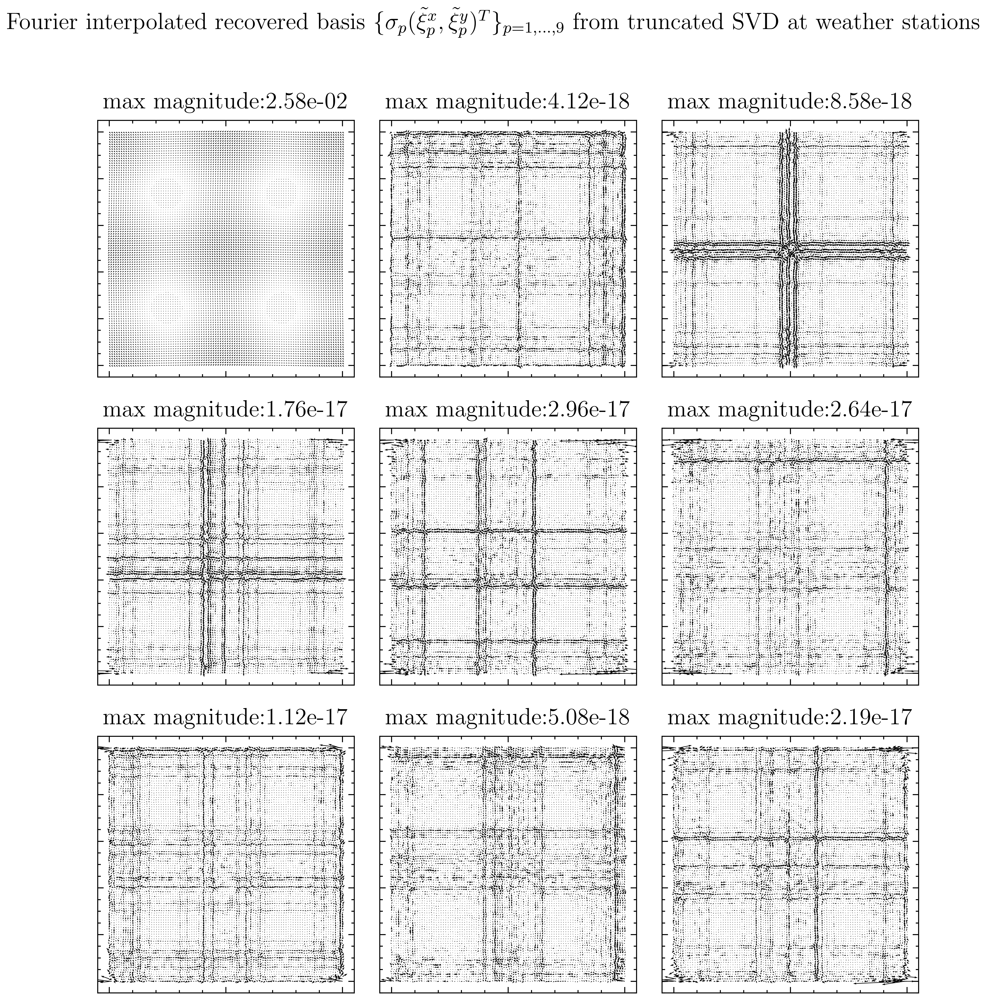

In [282]:
fig=plt.figure(2,figsize=(8,8))
norm = colors.Normalize(vmin=0, vmax=1)
for i in range(0,9):
    ax=fig.add_subplot(3,3,i+1) 
    Uf,Vf = Vel_fields_at_flattened_xypoints(xyarrf,xyarrd,D,Vh,i,xmind,xmaxd,ymind,ymaxd,ND)
    NF = int(np.sqrt(len(Uf)))
    ax.tick_params(
    axis='both',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=True,      # ticks along the bottom edge are off
    top=True,         # ticks along the top edge are off
    left=True,      # ticks along the bottom edge are off
    right=True,         # ticks along the top edge are off
    labelbottom=False,
    labelleft=False)
    #ax.set_xticklabels([])
    #ax.set_yticklabels([])
    ax.set_aspect('equal')
    E = ( Uf.reshape((NF,NF))**2+Vf.reshape((NF,NF))**2 )**0.5

    ax.title.set_text(f'max magnitude:{np.amax(E):.2e}')
    fig.subplots_adjust(wspace=-0.1, hspace=0.2)
    #im = ax.contour(xxd,yyd,E,alpha=1,levels=10,colors='k', linestyles='-',linewidth=0.1)
    #im = ax.imshow(E,extent=[xmind, xmaxd, ymind, ymaxd],cmap=cm.RdBu_r)

    # seed_points = np.array([xarr0, yarr0])
    # ax.plot(seed_points[0], seed_points[1], '.',linewidth=0.01,markersize=0.5)
    ##ax.streamplot(np.array(xxd),np.array(yyd),np.array(uarrd.reshape((ND,ND))),np.array(varrd.reshape((ND,ND))), color=np.array(E),start_points=seed_points.T)
    
    ax.quiver(xxf,yyf,Uf.reshape((NF,NF)),Vf.reshape((NF,NF)))
    #fig.colorbar(im)

fig.suptitle(r'Fourier interpolated recovered basis $\lbrace \sigma_p (\tilde{\xi}^{x}_{p},\tilde{\xi}^{y}_{p})^T \rbrace_{p=1,...,9} $ from truncated SVD at weather stations',fontsize=12) # or plt.suptitle('Main title')
plt.savefig(f'{cwd}/EN1_fourier_interpolated_svd_recovered_basis.png',dpi=300)

plt.show()

In [283]:
def sigma_recovered(xyarr,beta):
    P = len(beta)
    Matrix = jnp.zeros([len(xyarr),P])
    for i in range(0,P):
        u,v = Vel_fields_at_flattened_xypoints(xyarr,xyarrd,D,Vh,i)
        #Vel_fields_at_points(xyarrf,xyarrd,D,Vh,i,xmind,xmaxd,ymind,ymaxd)
        u = u.reshape(-1)
        v = v.reshape(-1)
        uv = x_and_y_to_xy(u,v)
        # reshape and stack them. 
        Matrix = Matrix.at[:,i].set(uv) # \in R^{2d,P}
    return Matrix 

def euler_recovered(xyarr, carr, sigma_recovered, dt, dz, beta, delta):
    xyarr = CFE(xyarr, carr, dt ,delta) + sigma_recovered(xyarr, beta) @ dz
    return xyarr

def ssp33_recovered(xyarr, carr, sigma_recovered, dt, dz, beta, delta):
    f1 = euler_recovered(xyarr, carr, sigma_recovered, dt, dz, beta, delta)
    f1 = 3 / 4 * f1 + 1 / 4 * euler_recovered(f1, carr, sigma_recovered, dt, dz, beta, delta)
    f1 = 1 / 3 * f1 + 2 / 3 * euler_recovered(f1, carr, sigma_recovered, dt, dz, beta, delta)
    #f1 = f1%1
    return f1

def integrate_recovered(step, xy0, carr, dts, dzs, beta, delta):
    def body(xyarr, dt_dz):
        dt, dz = dt_dz
        xyarr = step(xyarr, carr, sigma_recovered ,dt, dz, beta, delta)
        return xyarr, xyarr
    _, xys = jax.lax.scan(body, xy0, (dts, dzs))
    return jnp.insert(xys, 0, xy0, axis=0)

Below choose how many basis functions to run forwards with, and the corresponding recovered noise. 

In [284]:
PR=P
beta = jnp.ones(PR)
dzr = U[:,:PR] #pp number of dzs should i be using minus? 
print(dzr.shape)
# dzr = dbs[:len(dzr[:,0]),:]
dts = dts[:len(dzr[:,0])]
#dzr = dzr*0 + np.random.randn(*dzr.shape)*np.sqrt(dts[1]-dts[0])
print(dts.shape,dzr.shape)

(256, 1)
(256,) (256, 1)


We consider $dx + \tilde{u}dt+ u^{\delta} dt + \sum_{p=1}^{P}\sigma_p \tilde{\xi}_p(x_i)\circ dW_p$, where we take into account the time mean. 

In [285]:
time_mean_dt = (time_mean/dt)*dt
print(time_mean_dt.shape)

@partial(jit, static_argnums=(2,3,4,5,6)) # 0,1,2,3,4,5,6
def time_mean_at_xyfine(xyfine,time_mean_dt,xmind=xmind,xmaxd=xmaxd,ymind=ymind,ymaxd=ymaxd,ND=ND):
    """Evaluate a fourier interpolated recovered field, at the xyfine points. """
    _uarrd,_varrd = xy_to_x_and_y(time_mean_dt)
    _uarrd = _uarrd.reshape(ND,ND) 
    _varrd = _varrd.reshape(ND,ND)
    kx2d, ky2d = spectral_mesh(nx=ND,ny=ND,xmin=xmind,xmax=xmaxd,ymin=ymind,ymax=ymaxd)
    xarrfine,yarrfine = xy_to_x_and_y(xyfine)
    Ud,Vd = velocity_at_points_one_vers(u=_uarrd,v=_varrd,x_inputs=xarrfine,y_inputs=yarrfine,kx2d=kx2d,ky2d=ky2d)
    return Ud,Vd

def euler_time_mean(xyarr, carr, sigma_recovered, dt, dz, beta, delta, time_mean_dt):
    Ud,Vd = time_mean_at_xyfine(xyarr,time_mean_dt)
    UVD = x_and_y_to_xy(Ud,Vd)
    xyarr = CFE(xyarr, carr, dt ,delta) + UVD + sigma_recovered(xyarr, beta) @ dz
    return xyarr

def ssp33_time_mean(xyarr, carr, sigma_recovered, dt, dz, beta, delta, time_mean_dt):
    f1 = euler_time_mean(xyarr, carr, sigma_recovered, dt, dz, beta, delta, time_mean_dt)
    f1 = 3 / 4 * f1 + 1 / 4 * euler_time_mean(f1, carr, sigma_recovered, dt, dz, beta, delta, time_mean_dt)
    f1 = 1 / 3 * f1 + 2 / 3 * euler_time_mean(f1, carr, sigma_recovered, dt, dz, beta, delta, time_mean_dt)
    return f1

def integrate_time_mean(step, xy0, carr, dts, dzs, beta, delta, time_mean_dt):
    def body(xyarr, dt_dz):
        dt, dz = dt_dz
        xyarr = step(xyarr, carr, sigma_recovered ,dt, dz, beta, delta, time_mean_dt)
        return xyarr, xyarr
    _, xys = jax.lax.scan(body, xy0, (dts, dzs))
    return jnp.insert(xys, 0, xy0, axis=0)

(8192,)


In [286]:
xy_recovered = integrate_recovered(ssp33_recovered, xyarr0, carr, dts, dzr, beta, delta)
# reproduced is with time mean. in the case of no drift we wand time mean dt. 
xy_reproduced = integrate_time_mean(ssp33_time_mean, xyarr0, carr, dts, dzr, beta, delta, dt*time_mean_dt)
x_true = integrate(ssp33, xyarr0, carr, dts, dbs, theta_true, delta) # old method old increments

# takes 1 min 12

Animation: recovered driven signal, 

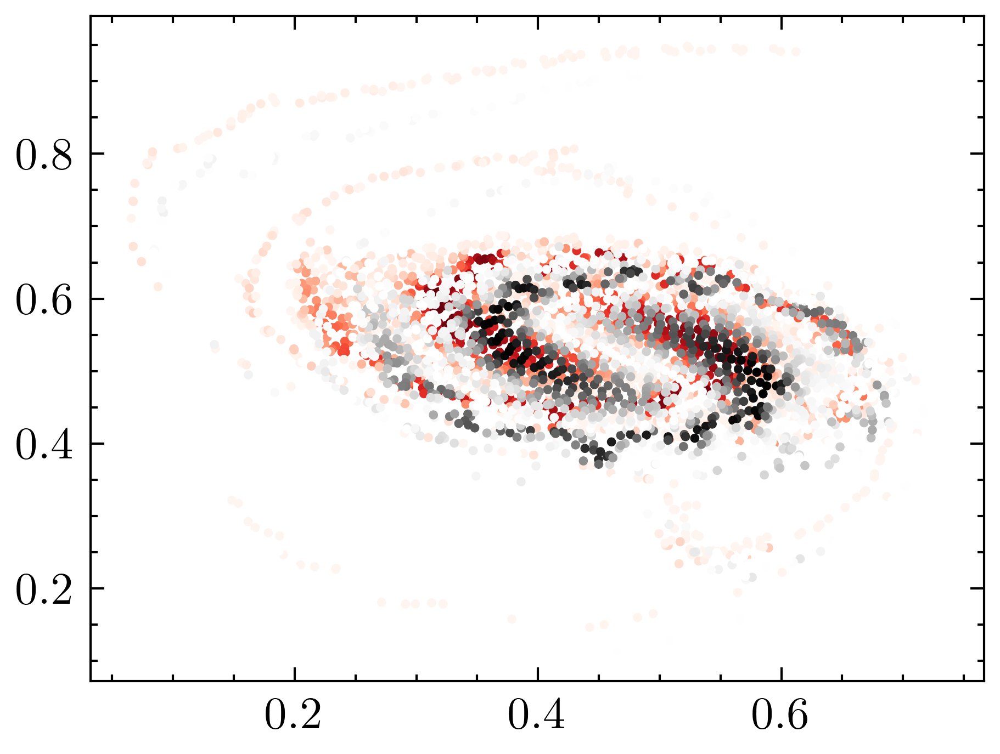

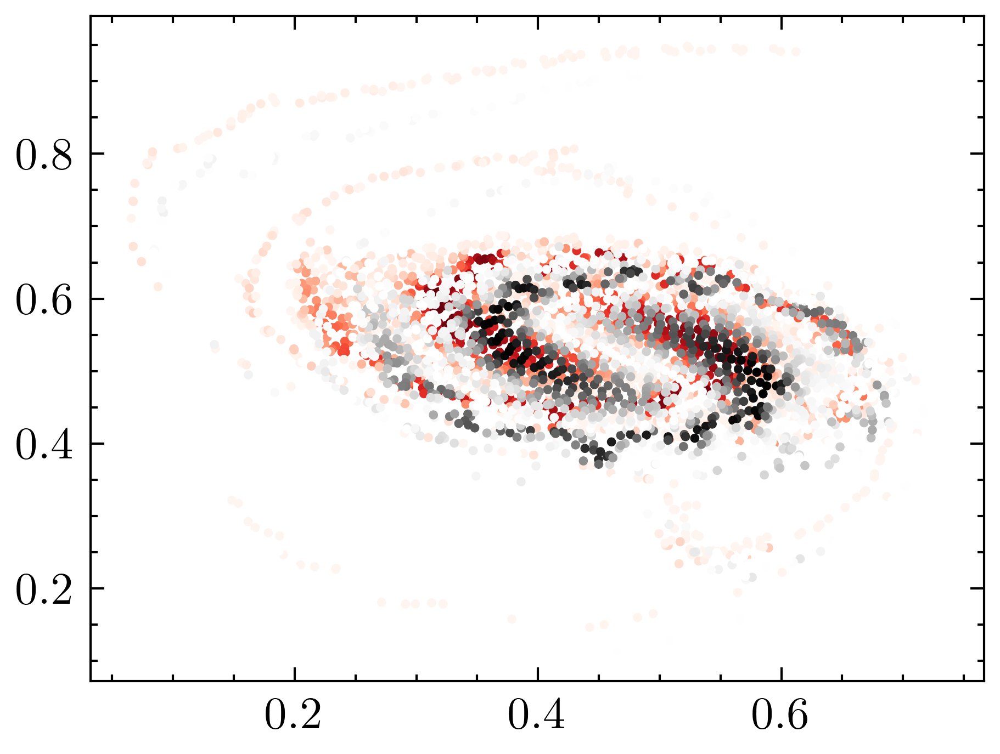

In [287]:
fig = plt.figure()
for i in range(0,len(dts)):
    if i%1==0:
        plt.clf()
        xarr_reproduced,yarr_reproduced = xy_to_x_and_y(xy_repoduced[i])
        xarr,yarr = xy_to_x_and_y(x_true[i])
        plt.scatter(xarr,yarr,c=carr,s=1,cmap = cm.Reds)
        plt.scatter(xarr_reproduced,yarr_reproduced,c=carr,s=1,cmap = cm.Greys)
        display.clear_output(wait=True)
        display.display(plt.gcf())
        time.sleep(0.01)
plt.show()

In [288]:
# print(jnp.linalg.norm((x_true-x_true).reshape(-1)))
# print(jnp.linalg.norm((x_true-x_blue).reshape(-1)))
# print(jnp.linalg.norm((x_true-xy_rt_oldMethod).reshape(-1)))
# print(jnp.linalg.norm(x_true-xy_dbs)) 
# print(jnp.linalg.norm(x_true-xy_repoduced)) # this is an order of magnitude closer in the L2 norm
# print("ok")
# print(jnp.linalg.norm(x_blue-x_true))
# print(jnp.linalg.norm(x_blue-x_blue))
# print(jnp.linalg.norm(x_blue-xy_rt_oldMethod))
# print(jnp.linalg.norm(x_blue-xy_dbs))
# print(jnp.linalg.norm(x_blue-xy_repoduced))

# print(jnp.linalg.norm(xy_rt_oldMethod-x_true))
# print(jnp.linalg.norm(xy_rt_oldMethod-x_blue))
# print(jnp.linalg.norm(xy_rt_oldMethod-xy_rt_oldMethod))
# print(jnp.linalg.norm(xy_rt_oldMethod-xy_dbs))
# print(jnp.linalg.norm(xy_rt_oldMethod-xy_repoduced))

# print(jnp.linalg.norm(xy_dbs-x_true))
# print(jnp.linalg.norm(xy_dbs-x_blue))
# print(jnp.linalg.norm(xy_dbs-xy_rt_oldMethod))
# print(jnp.linalg.norm(xy_dbs-xy_dbs))
# print(jnp.linalg.norm(xy_dbs-xy_repoduced))


print(f' error of the reproduced: time mean included solution is {jnp.linalg.norm((x_true-xy_repoduced).reshape(-1))}')
print(f' error of the recovered: time mean not included solution is {jnp.linalg.norm((x_true-xy_recovered).reshape(-1))}')

print(f'relative error of the reproduced time mean included solution is {jnp.linalg.norm((x_true-xy_repoduced).reshape(-1))/jnp.linalg.norm(x_true.reshape(-1))}')
print(f'relative error of the recovered time mean not included solution is {jnp.linalg.norm((x_true-xy_recovered).reshape(-1))/jnp.linalg.norm(x_true.reshape(-1))}')

#print(f'relative error of the using old perfect method with the recovered increments is {jnp.linalg.norm((x_true-x_blue).reshape(-1))/jnp.linalg.norm(x_true.reshape(-1))}')



 error of the reproduced: time mean included solution is 19.469143431522237
 error of the recovered: time mean not included solution is 25.943614944386447
relative error of the reproduced time mean included solution is 0.04126560329182082
relative error of the recovered time mean not included solution is 0.05498849633607634


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


0


<Figure size 2100x1575 with 0 Axes>

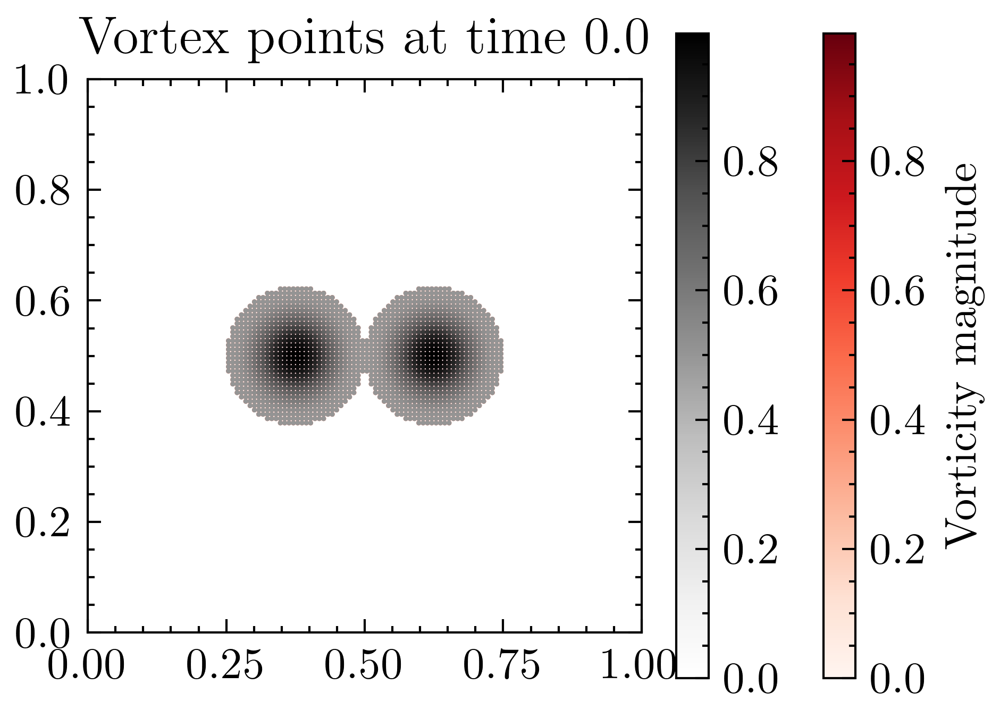

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


64


<Figure size 2100x1575 with 0 Axes>

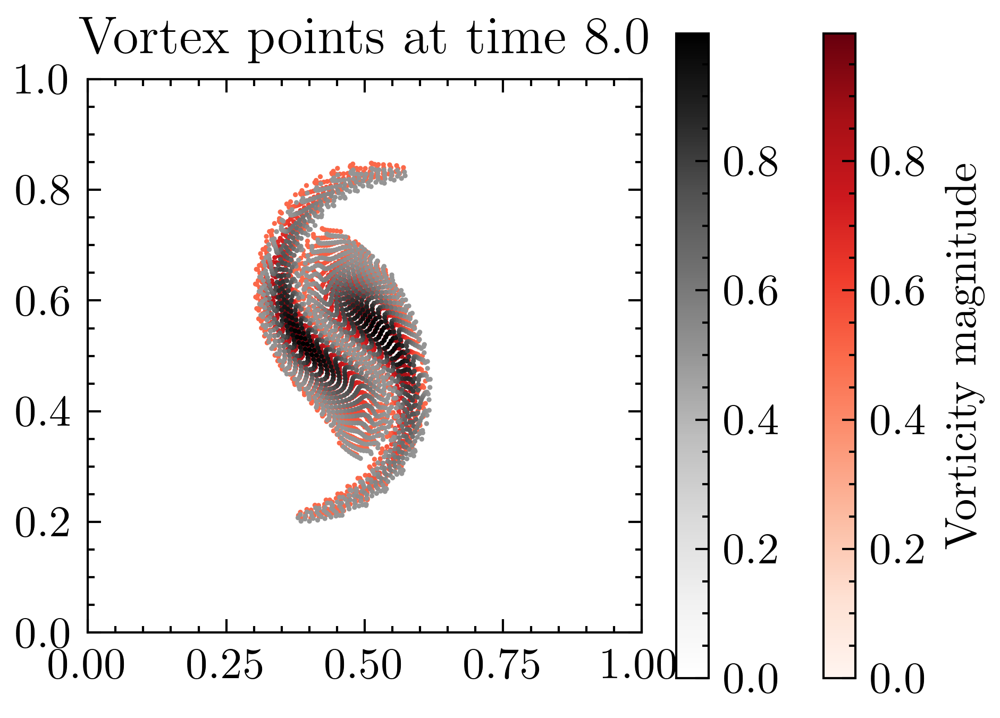

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


128


<Figure size 2100x1575 with 0 Axes>

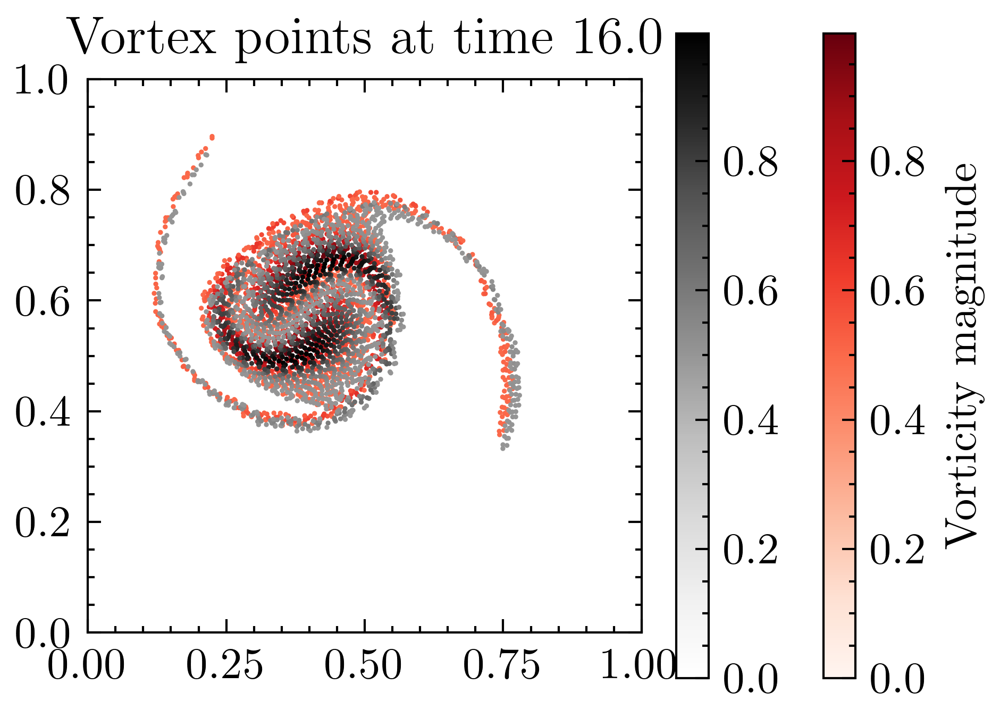

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


192


<Figure size 2100x1575 with 0 Axes>

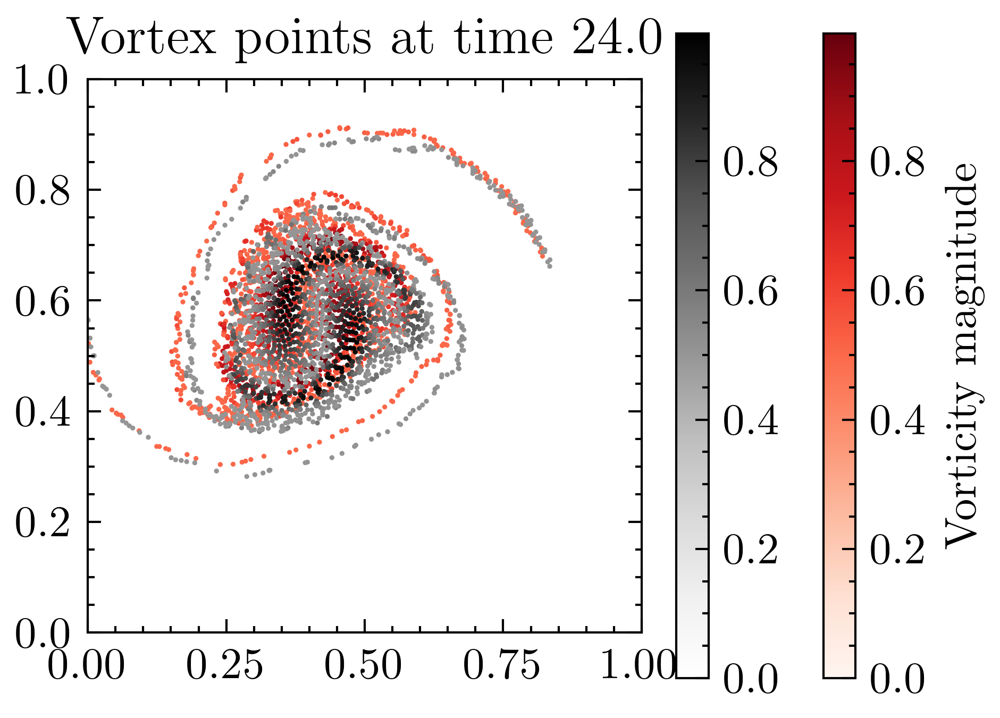

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


256


<Figure size 2100x1575 with 0 Axes>

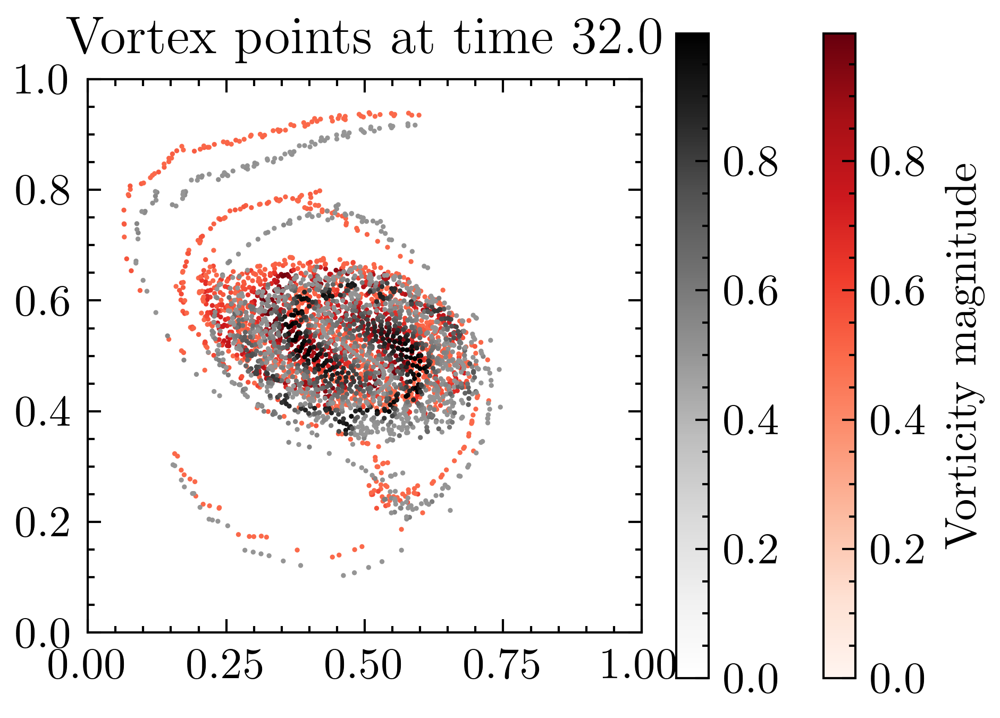

In [289]:
size_marker=5
for i in range(0,nt+1,int(nt/2**2)): # nt+1 initial conditions. 
    plt.clf()
    print(i)
    fig = plt.figure()
    ax = fig.add_subplot()
    xarr_reproduced,yarr_reproduced = xy_to_x_and_y(xy_repoduced[i]) # new method, recovered increments
    xarr,yarr = xy_to_x_and_y(x_true[i]) 
    cax1 = ax.scatter(xarr,yarr,c=carr/(hdx*hdy),marker='.',s=size_marker,cmap=cm.Reds,edgecolors='none',vmin=0)# most info.
    cax2 = ax.scatter(xarr_reproduced,yarr_reproduced,c=carr/(hdx*hdy),marker='.',s=size_marker,cmap=cm.Greys,edgecolors='none',vmin=0) # new method. 
    #cax3 = ax.scatter(xarr_tmo,yarr_tmo,c=carr/(hdx*hdy),marker='.',s=size_marker,cmap=cm.Greys,edgecolors='none')
    #measured_vel = det_vel(xarrd, yarrd, xarr_det, yarr_det, carr, delta)
    #uarrd,varrd = xy_to_x_and_y(measured_vel)    
    #plt.quiver(xxd,yyd,uarrd.reshape((ND,ND)),varrd.reshape((ND,ND)))
    ax.set_aspect('equal')
    ax.set_xlim(0.0,1)
    ax.set_ylim(0.0,1)
    cbar = fig.colorbar(cax1)
    cbar2 = fig.colorbar(cax2)

    cbar.ax.set_ylabel(f'Vorticity magnitude')
    plt.legend()
    plt.title(f"Vortex points at time {i*dt}")
    plt.savefig(f'{cwd}/EN1_Points_of_Fourier_interpolated_recovered_increment_Evolved_{i}.pdf',dpi=300)
    plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


0


<Figure size 2100x1575 with 0 Axes>

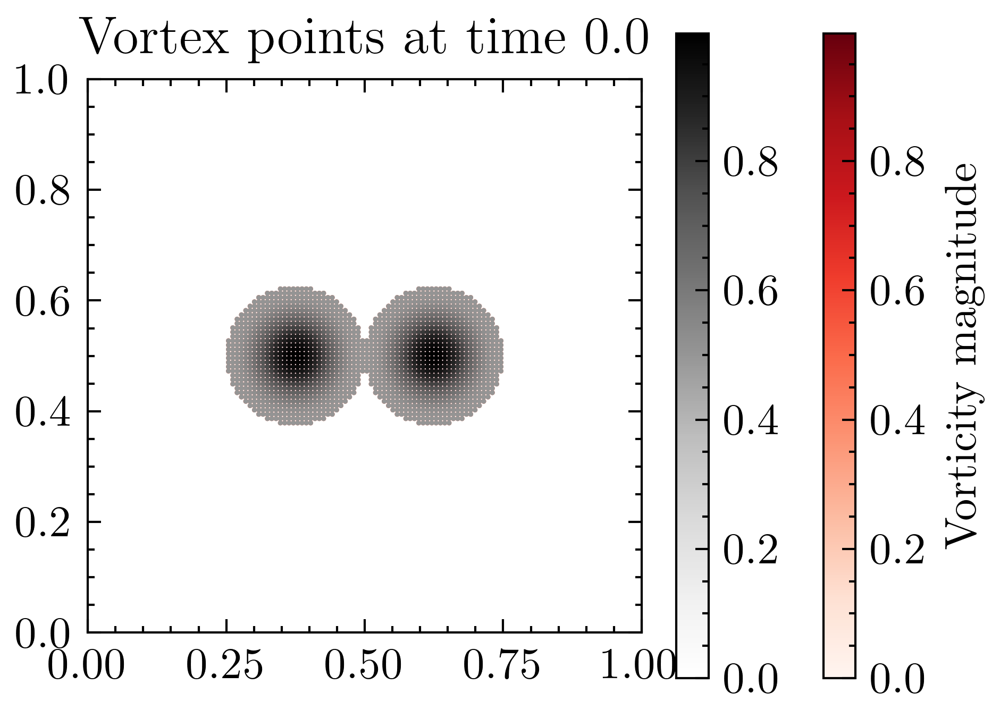

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


64


<Figure size 2100x1575 with 0 Axes>

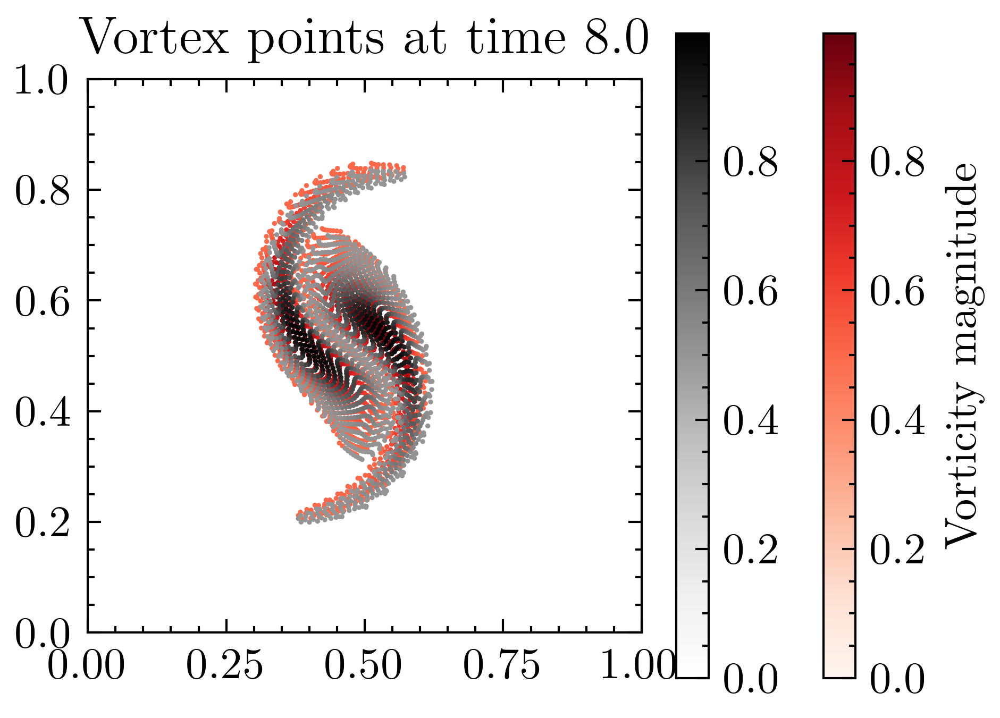

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


128


<Figure size 2100x1575 with 0 Axes>

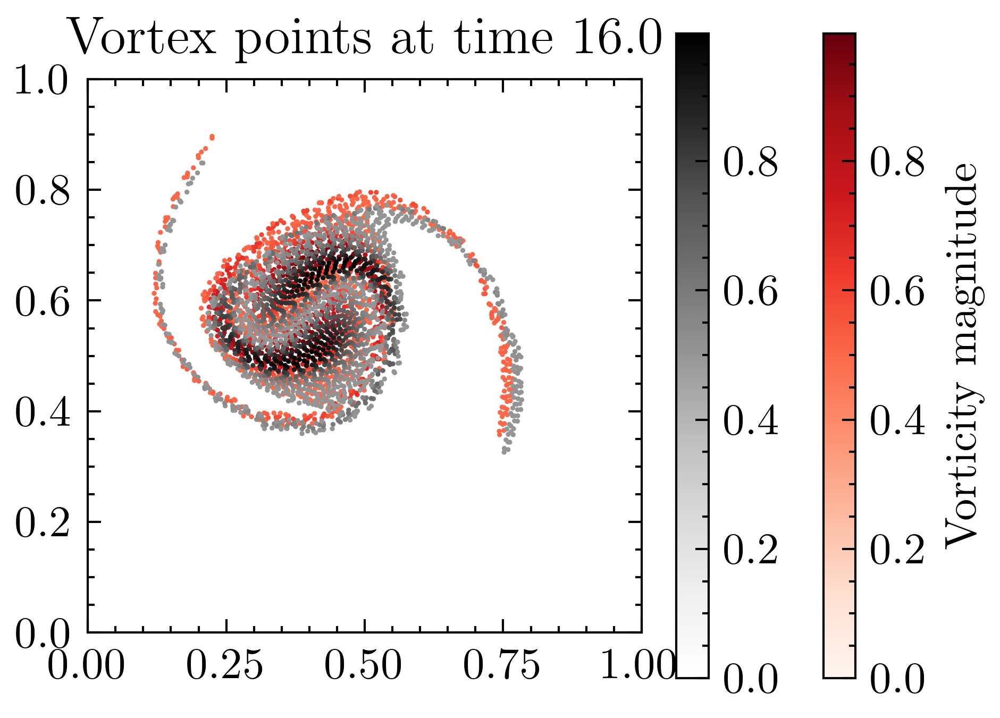

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


192


<Figure size 2100x1575 with 0 Axes>

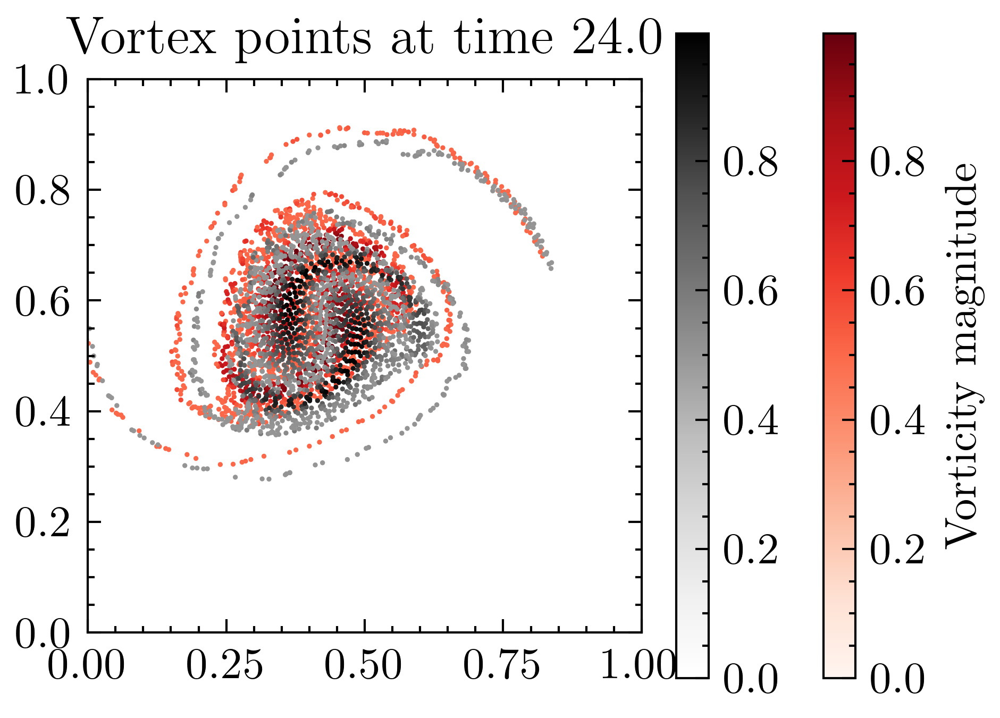

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


256


<Figure size 2100x1575 with 0 Axes>

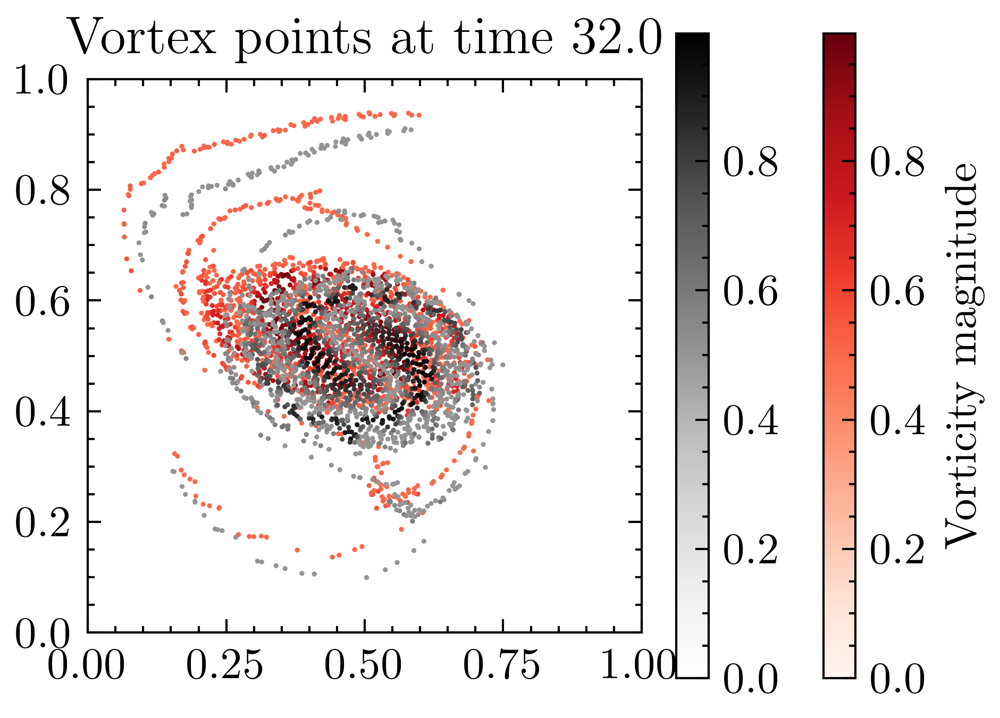

In [290]:
size_marker=5
for i in range(0,nt+1,int(nt/2**2)): # nt+1 initial conditions. 
    plt.clf()
    print(i)
    fig = plt.figure()
    ax = fig.add_subplot()
    xarr_reproduced,yarr_reproduced = xy_to_x_and_y(xy_repoduced[i]) # new method, recovered increments
    xarr,yarr = xy_to_x_and_y(x_true[i]) # data
    xarr2,yarr2 = xy_to_x_and_y(xy_dbs[i])# old increments, new method, wildly wrong? 
    #xarr3,yarr3 = xy_to_x_and_y(xy_rt_oldMethod[i]) # new increments, old method, wildly w
    xarr4,yarr4 = xy_to_x_and_y(x_blue[i]) # new increments, old method, wildly w
    xarr_recovered,yarr_recovered = xy_to_x_and_y(xy_recovered[i]) # new method, recovered increments

    #xarr_reproduced,yarr_reproduced = xy_to_x_and_y(xy_rt_oldMethod[i])
    #xarr_reproduced,yarr_reproduced = xy_to_x_and_y(xy_tmo[i])
    #cax4 = ax.scatter(xarr4,yarr4,c=carr/(hdx*hdy),marker='.',s=size_marker,cmap=cm.Blues,edgecolors='none')# most info.
    #cax3 = ax.scatter(xarr3,yarr3,c=carr/(hdx*hdy),marker='.',s=size_marker,cmap=cm.Blues,edgecolors='none')# most info.
    #cax0 = ax.scatter(xarr2,yarr2,c=carr/(hdx*hdy),marker='.',s=size_marker,cmap=cm.Blues,edgecolors='none')# most info.
    cax1 = ax.scatter(xarr,yarr,c=carr/(hdx*hdy),marker='.',s=size_marker,cmap=cm.Reds,edgecolors='none',vmin=0)# most info.
    cax2 = ax.scatter(xarr_recovered,yarr_recovered,c=carr/(hdx*hdy),marker='.',s=size_marker,cmap=cm.Greys,edgecolors='none',vmin=0) # new method. 
    #cax3 = ax.scatter(xarr_tmo,yarr_tmo,c=carr/(hdx*hdy),marker='.',s=size_marker,cmap=cm.Greys,edgecolors='none')
    
    #measured_vel = det_vel(xarrd, yarrd, xarr_det, yarr_det, carr, delta)
    #uarrd,varrd = xy_to_x_and_y(measured_vel)    
    #plt.quiver(xxd,yyd,uarrd.reshape((ND,ND)),varrd.reshape((ND,ND)))
    ax.set_aspect('equal')
    ax.set_xlim(0.0,1)
    ax.set_ylim(0.0,1)
    cbar = fig.colorbar(cax1)
    cbar2 = fig.colorbar(cax2)

    cbar.ax.set_ylabel(f'Vorticity magnitude')
    plt.legend()
    plt.title(f"Vortex points at time {i*dt}")
    plt.savefig(f'{cwd}/EN1_NoTM_Points_of_Fourier_interpolated_recovered_increment_Evolved_{i}.pdf',dpi=300)
    plt.show()

For validation; we now perform new ensemble preditions, using new samples.


We also perform new data set creation, in which we use new normal distributed variables.

In [291]:
print("nt:", nt) 
key = jax.random.PRNGKey(5)
P = 1
E = 30
dbs_E = jnp.sqrt(dt) * jax.random.normal( key, shape=(nt,P*E) )
dbs_E2 = dbs_E.reshape((nt,P,E))
npx = len(xyarr0)
sol = np.zeros([nt+1,npx,E])
sol2 = np.zeros([nt+1,npx,E])
sol3 = np.zeros([nt+1,npx,E])
sol4 = np.zeros([nt+1,npx,E])
sol5 = np.zeros([nt+1,npx,E])
solml = np.zeros([nt+1,npx,E])
for e in range(0,E):
    dbs_e = dbs_E2[:,:,e]
    xy_ml = integrate(ssp33, xyarr0, carr, dts, dbs_e, theta_ml, delta)
    xy_repoduced = integrate_time_mean(ssp33_time_mean, xyarr0, carr, dts, dbs_e, beta, delta, time_mean_dt)
    xy_true_method = integrate(ssp33, xyarr0, carr, dts, dbs_e, theta_true, delta)
    xy_recovered = integrate_recovered(ssp33_recovered, xyarr0, carr, dts, dbs_e, beta, delta)
    xy_peturbed = integrate(ssp33, xyarr0 + e*0.001*np.random.randn(len(xyarr0)), carr, dts, dbs_e*0, theta_true, delta)
    sol[:,:,e] = xy_repoduced 
    sol2[:,:,e] = xy_true_method
    sol3[:,:,e] = xy_recovered
    sol4[:,:,e] = xy_peturbed
    solml[:,:,e] = xy_ml    
    
# this is a hugely expensive operation. 
# E = 30, NM = 32, P=1 results in a 8 minute experiment.  # 2^3
# E = 30, NM = 128, P=1 results in a 27 minute experiment. # 2^3
# E = 30, NM = 256, P=1 results in a 2hr
# for some reason 39 minutes. 

nt: 256


In [292]:
key_val = jax.random.PRNGKey(21)
P = 1
E_VAL = 1000
dbs_E_val = jnp.sqrt(dt) * jax.random.normal( key_val, shape=(nt,P*E_VAL) )
dbs_E_val = dbs_E_val.reshape((nt,P,E_VAL))
npx = len(xyarr0)
sol_val = np.zeros([nt+1,npx,E_VAL])
for e in range(0,E_VAL):
    dbs_e = dbs_E_val[:,:,e]
    xy_true_method = integrate(ssp33, xyarr0, carr, dts, dbs_e, theta_true, delta)
    sol_val[:,:,e] = xy_true_method
val = sol_val
# 1 min 30 to complete for 30
# 5 min for 100 48minhr got 1000

In [293]:
import properscoring as ps
slic = np.s_[256] 
ensemble1 = sol#[slic,:] # nx,nx,nt,E, ensemble method one is 
perfect = sol2#[slic,:]
ensemble2 = sol3#[slic,:]
baseline = sol4#[slic,:] # RIC
sol5 = np.einsum('i,j,k->ijk',np.ones(nt+1),xyarr0,np.ones(E)) 
persistence = sol5#[slic,:]
#obs = x_true
obs = val[:,:,10] # we take a new realisation of the data. 
# print(persistence.shape)
# print(baseline.shape)
# print(obs.shape)

#CRPS = 0 the forecast is wholly accurate; CRPS = 1 the forecast is wholly inaccurate
baseline_score = ps.crps_ensemble(obs, baseline).mean()  # ric
forecast_score1 = ps.crps_ensemble(obs, ensemble1).mean() # with time mean included
forecast_score2 = ps.crps_ensemble(obs, ensemble2).mean() # without time mean 
perfect_score = ps.crps_ensemble(obs, perfect).mean() # perfect
persistence_score = ps.crps_ensemble(obs, persistence).mean() # persistence
ml_score = ps.crps_ensemble(obs, solml).mean() # learned

baseline_score_average = baseline_score*0
forecast_score1_average = baseline_score*0
forecast_score2_average = baseline_score*0
perfect_score_average = baseline_score*0
persistence_score_average = baseline_score*0
ml_score_average = baseline_score*0
E_VAL=1000

@jax.jit
def My_CRPS(obs,forcast):
    # assumes for example:  (10,10),(10,10,E) 
    observations = jnp.asarray(obs)
    forecasts = jnp.asarray(forcast)
    observations = observations[..., jnp.newaxis]
    score = jnp.mean(jnp.abs(forecasts - observations), -1)
    forecasts_diff = (jnp.expand_dims(forecasts, -1) -
                      jnp.expand_dims(forecasts, -2))
    
    score = score -0.5 * jnp.mean( jnp.abs(forecasts_diff),
                                       axis=(-2, -1))
    
    return score

for e in range(0,E_VAL):
    if e%100==0:
        print(e)
    baseline_score_average +=  My_CRPS(val[:,:,e], baseline).mean()/E_VAL
    forecast_score1_average += My_CRPS(val[:,:,e], ensemble1).mean()/E_VAL
    forecast_score2_average += My_CRPS(val[:,:,e], ensemble2).mean()/E_VAL
    perfect_score_average += My_CRPS(val[:,:,e], perfect).mean()/E_VAL
    persistence_score_average += My_CRPS(val[:,:,e], persistence).mean()/E_VAL
    ml_score_average += My_CRPS(val[:,:,e], solml).mean()/E_VAL


my_persistence_score = My_CRPS(obs, persistence).mean()

#print(persistence_score,my_persistence_score)

df = pd.DataFrame(dict(scheme=[r'Persistence', r'Randomised initial condition',r'Perfect model',r'without time mean',r'with time mean'],
                       value= [f'{persistence_score:.3e}', f'{baseline_score:.3e}',f'{perfect_score:.3e}',f'{forecast_score2:.3e}',f'{forecast_score1:.3e}']))
print(df.to_latex(index=False,
                  formatters={"name": str},
                  float_format="{:.1f}".format))

print(f'ml score {ml_score:.3e}')

df = pd.DataFrame(dict(scheme=[r'Persistence Averaged', r'Randomised initial condition Averaged',r'Perfect model Averaged',r'without time mean Averaged',r'with time mean Averaged'],
                       value= [f'{persistence_score_average:.3e}', f'{baseline_score_average:.3e}',f'{perfect_score_average:.3e}',f'{forecast_score2_average:.3e}',f'{forecast_score1_average:.3e}']))
print(df.to_latex(index=False,
                  formatters={"name": str},
                  float_format="{:.1f}".format))

print(f'ml score average {ml_score_average:.3e}')

print(f'random{baseline_score},with time mean{forecast_score1},without{forecast_score2},SPDE{perfect_score},persistence{persistence_score}')


skillb1 = 1 - (forecast_score1_average) / (baseline_score_average)
skillb2 = 1 - (forecast_score2_average) / (baseline_score_average)
skillbp = 1 - (perfect_score_average) / (baseline_score_average)
skillbc = 1 - (persistence_score_average) / (baseline_score_average)

#(x-y)/x = 1-y/x  # if x gets a larger value than y, then this is close to 1. 

print(f'ensemble method 1 (time mean included) was {100*skillb1} percent better than random_peturbed initial conditoins at predicting the particle positions.')
print(f'ensemble method 2 (time mean not included) was {100*skillb2} percent better than random_peturbed initial conditoins at predicting the particle positions.')
print(f'perfect ensemble method (true spde) was {100*skillbp} percent better than random_peturbed initial conditoins ensemble at predicting the particle positions.')
print(f'persistence was {100*skillbc} percent better than peturbing the inititial positions at predicting the particle positions.')


skillq = 1 - (baseline_score_average) / (persistence_score_average)
skillw = 1 - (forecast_score2_average) / (persistence_score_average)
skille = 1 - (perfect_score_average) / (persistence_score_average)
skillr = 1 - (forecast_score1_average) / (persistence_score_average)
print(f'random peturbed ic was {100*skillq} percent better than persistence')
print(f'time mean not included  was {100*skillw} percent better than persistence')
print(f'perfect model was {100*skille} percent better than persistence' )
print(f'time mean was {100*skillr} percent better than persistence' )

skilly = 1 - (forecast_score2_average) / (baseline_score_average)
skillu = 1 - (perfect_score_average) / (baseline_score_average)
skilli = 1 - (forecast_score1_average) / (baseline_score_average)
print(f'time mean not included was{100*skillw} percent better than random_peturbed')
print(f'perfect model was {100*skille} percent better than random_peturbed' )
print(f'time mean was {100*skillr} percent better than random_peturbed' )

skilla = 1 - (perfect_score_average) / (forecast_score2_average)
skills = 1 - (forecast_score1_average) / (forecast_score2_average)
print(f'perfect model was {100*skilla} percent better than time mean not included')
print(f'time mean was {100*skills} percent better than time mean not included' )

skilld = 1 - (forecast_score1_average) / (perfect_score_average)
print(f'time mean was {100*skilld:.4g} percent better than perfect' )


# df = pd.DataFrame(dict(scheme=[r'Persistence', r'Randomised_ic',r'Perfect',r'without time mean',r'with time mean'],
#                        Persistence = [f'{0:.3e}', f'{skillq:.3e}',f'{skillw:.3e}',f'{skille:.3e}',f'{skillr:.3e}'],
#                        Randomised_ic= [f'{0:.3e}', f'{0:.3e}',f'{skilly:.3e}',f'{skillu:.3e}',f'{skilli:.3e}'],
#                        Perfect = [f'{0:.3e}', f'{0:.3e}',f'{0:.3e}',f'{skilla:.3e}',f'{skills:.3e}'],
#                        without_time_mean = [f'{0:.3e}', f'{0:.3e}',f'{0:.3e}',f'{0:.3e}',f'{skilld:.3e}']

#                        ))

# print(df.to_latex(index=False,
#                   formatters={"name": str},
#                   float_format="{:.1f}".format))


sbb = 1 - (baseline_score_average) / (baseline_score_average)
sb1 = 1 - (forecast_score1_average) / (baseline_score_average)
sb2 = 1 - (forecast_score2_average) / (baseline_score_average)
sbp = 1 - (perfect_score_average) / (baseline_score_average)
sbc = 1 - (persistence_score_average) / (baseline_score_average)

s1b = 1 - (baseline_score_average) / (forecast_score1_average)
s11 = 1 - (forecast_score1_average) / (forecast_score1_average)
s12 = 1 - (forecast_score2_average) / (forecast_score1_average)
s1p = 1 - (perfect_score_average) / (forecast_score1_average)
s1c = 1 - (persistence_score_average) / (forecast_score1_average)

s2b = 1 - (baseline_score_average) / (forecast_score2_average)
s21 = 1 - (forecast_score1_average) / (forecast_score2_average)
s22 = 1 - (forecast_score2_average) / (forecast_score2_average)
s2p = 1 - (perfect_score_average) / (forecast_score2_average)
s2c = 1 - (persistence_score_average) / (forecast_score2_average)

spb = 1 - (baseline_score_average) / (perfect_score_average)
sp1 = 1 - (forecast_score1_average) / (perfect_score_average)
sp2 = 1 - (forecast_score2_average) / (perfect_score_average)
spp = 1 - (perfect_score_average) / (perfect_score_average)
spc = 1 - (persistence_score_average) / (perfect_score_average)

scb = 1 - (baseline_score_average) / (persistence_score_average)
sc1 = 1 - (forecast_score1_average) / (persistence_score_average)
sc2 = 1 - (forecast_score2_average) / (persistence_score_average)
scp = 1 - (perfect_score_average) / (persistence_score_average)
scc = 1 - (persistence_score_average) / (persistence_score_average)

df = pd.DataFrame(dict(scheme=[r'Randomised_ic', r'with time mean',r'without time mean' , r'Perfect', r'Persistence' ],
                       Randomised_ic = [f'{100*sbb:.4g}', f'{100*sb1:.4g}',f'{100*sb2:.4g}',f'{100*sbp:.4g}',f'{100*sbc:.4g}'],
                       with_time_mean= [f'{100*s1b:.4g}', f'{100*s11:.4g}',f'{100*s12:.4g}',f'{100*s1p:.4g}',f'{100*s1c:.4g}'],
                       without_time_mean = [f'{100*s2b:.4g}', f'{100*s21:.4g}',f'{100*s22:.4g}',f'{100*s2p:.4g}',f'{100*s2c:.4g}'],
                       Perfect = [f'{100*spb:.4g}', f'{100*sp1:.4g}',f'{100*sp2:.4g}',f'{100*spp:.4g}',f'{100*spc:.4g}'],
                       Persistence = [f'{100*scb:.4g}', f'{100*sc1:.4g}',f'{100*sc2:.4g}',f'{100*scp:.4g}',f'{100*scc:.4g}'],
                       ))

print(df.to_latex(index=False,
                  formatters={"name": str},
                  float_format="{:.1f}".format))

# taking like 2mins. to complete. with E=1000 takes 30 mins, jit makes it 5. 

0
100
200
300
400
500
600
700
800
900
\begin{tabular}{ll}
\toprule
scheme & value \\
\midrule
Persistence & 1.512e-01 \\
Randomised initial condition & 7.174e-02 \\
Perfect model & 6.141e-02 \\
without time mean & 6.103e-02 \\
with time mean & 6.928e-02 \\
\bottomrule
\end{tabular}

ml score 6.260e-02
\begin{tabular}{ll}
\toprule
scheme & value \\
\midrule
Persistence Averaged & 1.501e-01 \\
Randomised initial condition Averaged & 7.598e-02 \\
Perfect model Averaged & 6.836e-02 \\
without time mean Averaged & 6.834e-02 \\
with time mean Averaged & 6.979e-02 \\
\bottomrule
\end{tabular}

ml score average 6.944e-02
random0.071735935235061,with time mean0.06928363249771115,without0.061027026316465324,SPDE0.06140982518891704,persistence0.15115790708473342
ensemble method 1 (time mean included) was 8.14792147329495 percent better than random_peturbed initial conditoins at predicting the particle positions.
ensemble method 2 (time mean not included) was 10.057567459659001 percent better than